Builds on [elliptical_sersic_fitting](elliptical_sersic_fitting.ipynb)

In [20]:
# needed on macs due to subtle multiprocessing differences used in dynesty
import sys
import multiprocessing
if sys.platform == 'darwin':
    multiprocessing.set_start_method('fork')

njobs = multiprocessing.cpu_count()  # might need to be modified for optimal behavior on a specific machine - e.g. computers with fast and slow cores
njobs

12

In [2]:
import math

import numpy as np
np.seterr(invalid='ignore')

from scipy import special, stats

import sympy

import regions
from regions import CirclePixelRegion, PixCoord, RectanglePixelRegion, CirclePixelRegion, PolygonPixelRegion

from tqdm.notebook import tqdm

import dynesty
from dynesty import plotting as dyplot

In [21]:
from matplotlib import pyplot as plt
from IPython.display import display
%matplotlib agg

# Initial setup

In [4]:
TWOPI = 2*np.pi

bn

In [5]:
ICOEFFS = [2, -1/3, 4/405, 46/25515, 131/1148175, -2194697/30690717750]

def f_bn(n):
    """
    Ciotti and Bertin 99, valid for n >~ 0.36
    """
    return np.sum([C*n**(1-i) for i, C in enumerate(ICOEFFS)], axis=0)

def sersic_profile(R, Ie, Re, n):
    bn = f_bn(n)
    return Ie * np.exp(-bn*((R/Re)**(1/n)-1))

def log_sersic_profile(R, Ie, Re, n):
    bn = f_bn(n)
    return np.log(Ie) - bn*((R/Re)**(1/n)-1)

sersic integral functions

In [6]:
def make_grid_Iweighted(nr, nphi, outerr, Re, n):
    bn_val = f_bn(n)

    gamma2 = special.gammainc(2*n, outerr**(1/n) * Re**(-1/n) * bn_val)

    u = np.linspace(0, 1, nr)
    r = Re * (special.gammaincinv(2*n, u * gamma2) / bn_val)**n
    phi = np.linspace(0, 2*np.pi, nphi+1)[:-1]

    return np.meshgrid(r, phi)

def sersic_outer_integral(Router, Re, n, e):
    bnval = f_bn(n)
    numer1 = 4 * np.pi * Re * Re * bnval**(-2*n) * n*n * np.exp(bnval) * (1-e)
    
    # non-trivial thing here: the scipy gammainc is a *regularized* gamma function meaning it has a factor of 1/gamma(s), 
    # so we square our prefactor to have scipy's gammainc match the sympy definition which is not regularized
    numer2 = special.gamma(2*n)**2 * special.gammainc(2*n, Router**(1/n) * Re**(-1/n) * bnval)
    
    denom = special.gamma(2*n + 1)

    return numer1 * numer2 / denom

def sersic_integral(Re, n, e, pa, region, x0=0, y0=0, nr=100, nphi=100):
    """
    Note the the region, Re, x0, and y0 should all be in pixels
    """

    outerr = np.max(np.abs(region.bounding_box.extent))
    outer_integ = sersic_outer_integral(outerr, Re, n, e)

    r, phi = make_grid_Iweighted(nr, nphi, outerr, Re, n)
    xg_unrotated = r*(1-e)*np.cos(phi) + x0
    yg_unrotated = r*np.sin(phi) + y0
    c = np.cos(pa)
    s = np.sin(pa)
    xg = xg_unrotated * c + yg_unrotated * s
    yg = xg_unrotated *-s + yg_unrotated * c
    msk = region.contains(regions.PixCoord(x=xg, y=yg))

    frac_in_grid = np.sum(msk)/msk.size

    return outer_integ * frac_in_grid

mock galaxy generator functions

In [7]:
def get_sersic_r(npoints, outerr, Re, n, rstate=np.random.default_rng()):
    bn_val = f_bn(n)

    gammaparam = 2*n

    gamma2 = special.gammainc(gammaparam, outerr**(1/n) * Re**(-1/n) * bn_val)

    u = rstate.uniform(size=npoints)
    r = Re * (special.gammaincinv(gammaparam, u * gamma2) / bn_val)**n

    return r

def generate_unif_box(n=None, halfsize=1, density=None, rstate=np.random.RandomState()):
    if n is not None and density is not None:
        raise ValueError('cannot give both n and density')
    elif density is not None:
        A = (halfsize*2)**2
        n = density * A
        
    if n != int(n):
        remainder = n - int(n)
        n = int(n)
        if np.random.rand(1)[0] < remainder:
            n += 1
    else:
        n = int(n)
        
    x = rstate.uniform(-halfsize, halfsize, n)
    y = rstate.uniform(-halfsize, halfsize, n)

    return x, y

def uniform_in_region(density, region, rstate=np.random.RandomState()):
    maxpx = np.max(region.bounding_box.extent)
    xs, ys = generate_unif_box(halfsize=maxpx, density=density, rstate=rstate)

    return subselect_in_region(xs, ys, region)[:2]
    
def generate_sersic_dglx(n=None, Re=1, nsersic=1.5, e=0, pa=0, density=None, region=None, rstate=np.random.RandomState()):
    if n is not None and density is not None:
        raise ValueError('cannot give both n and density')
    elif density is not None:
        # density is the mean density within the HLR
        hA = np.pi*Re**2
        n = 2 * density * hA
        
    if n != int(n):
        remainder = n - int(n)
        n = int(n)
        if np.random.rand(1)[0] < remainder:
            n += 1
    else:
        n = int(n)
        
    r = get_sersic_r(n, np.inf, Re, nsersic, rstate)
    phi = rstate.uniform(0, 2*np.pi, n)

    x_unrotated = (1-e) * np.cos(phi)*r
    y_unrotated = np.sin(phi)*r

    c = np.cos(pa)
    s = np.sin(pa)
    x = x_unrotated * c + y_unrotated * s
    y = x_unrotated *-s + y_unrotated * c

    if region is not None:
        x,y,_ = subselect_in_region(x, y, region)

    return x, y

def subselect_in_region(x, y, region):
    msk = region.contains(PixCoord(x, y))
    return x[msk], y[msk], msk

def glx_and_uniform(glx_hdensity, bkg_density, region, Re=1, nsersic=1.25, e=0, pa=0, rstate=np.random.RandomState()):
    g = generate_sersic_dglx(density=glx_hdensity, Re=Re, nsersic=nsersic, region=region, rstate=rstate, e=e, pa=pa)
    b = uniform_in_region(bkg_density, region=region, rstate=rstate)

    return np.concatenate((g, b), axis=1), g, b

And the model:

In [8]:
param_names = 'x0, y0, Re, n, e, padeg, fbkg'.split(', ')

param_names_to_index = {nm: i for i, nm in enumerate(param_names)}
index_to_param_names = {a:b for b,a in param_names_to_index.items()}
assert len(param_names_to_index) == len(param_names)

In [122]:
LTWOPI = np.log(2*np.pi)

def loglike(p, data, region, retcomponents=False):
    x0, y0, Re, n, e, padeg, fbkg = p
    pa = math.radians(padeg)
    cparam = 1 - e
    x, y = data

    dx0 = x-x0
    dy0 = y-y0
    c = math.cos(pa)
    s = math.sin(pa)
    x_rotated = dx0 * c + dy0 *-s
    y_rotated = dx0 * s + dy0 * c


    r = np.hypot(x_rotated/cparam, y_rotated)
    lgal = np.log(1-fbkg) + log_sersic_profile(r, 1, Re, n) - np.log(sersic_integral(Re, n, region=region, x0=x0, y0=y0, nr=500, nphi=100, e=e, pa=pa))
    lbkg = np.log(fbkg/region.area)
    ll = np.logaddexp(lgal, lbkg)

    if retcomponents:
        return ll, lgal, lbkg*np.ones_like(lgal)
    else:
        return np.sum(ll)
    

In [10]:
def stats_prior_transform_f(u, distrsufuncs):
    x = np.empty_like(u)
    for i in range(len(x)):
        x[i] = distrsufuncs[i](u[i])
    return x

# Fiducial case, known to not fit well

In [11]:
rectangular_small_reg = RectanglePixelRegion(PixCoord(0, 0), 6, 6)

In [13]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.reciprocal(.1, 5),
    'n':stats.uniform(loc=.75, scale=1.25),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.99),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(40))
truths = [0, 0, 1, 1.25, 0.5, 40, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})

20922it [01:27, 238.60it/s, batch: 3 | bound: 8 | nc: 1 | ncall: 514135 | eff(%):  3.969 | loglstar: -883.559 < -875.746 < -882.186 | logz: -902.068 +/-  0.177 | stop:  0.995]         


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


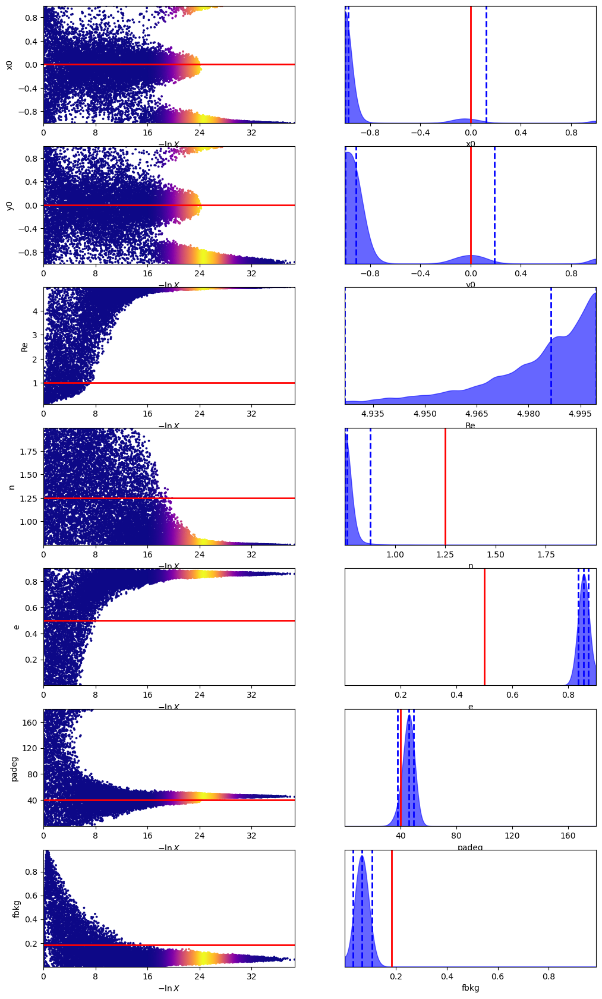

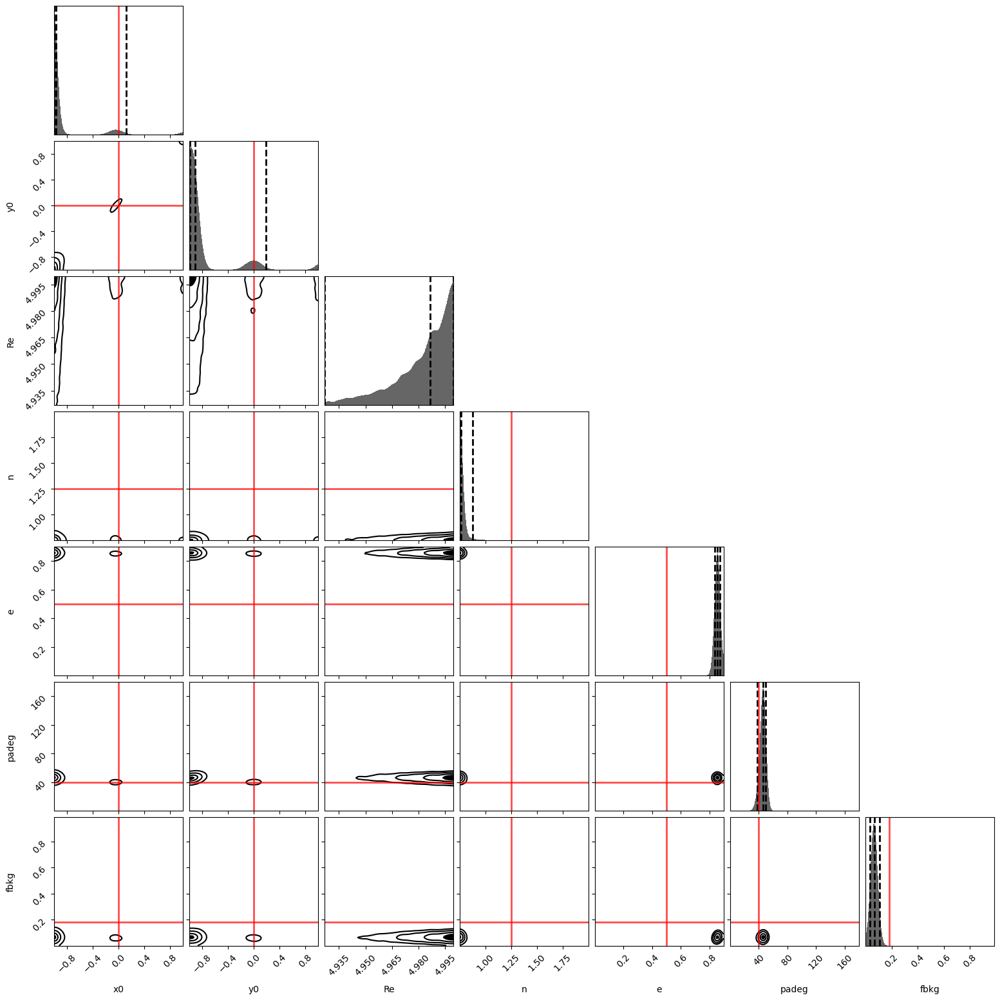

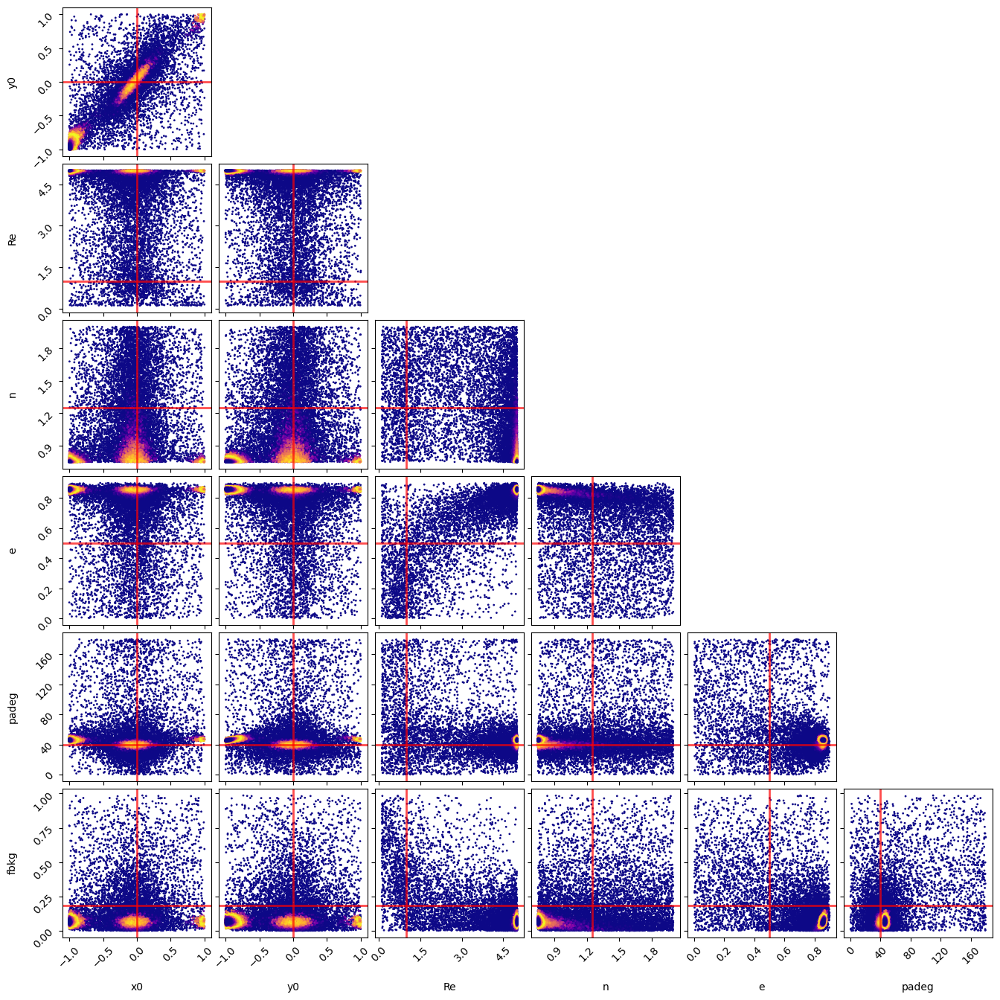

In [22]:
fig, axes = dyplot.runplot(dsampler.results)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(dsampler.results, labels=param_names, truths=truths)
display(fig)

Make a visualization of the probability map for the sources

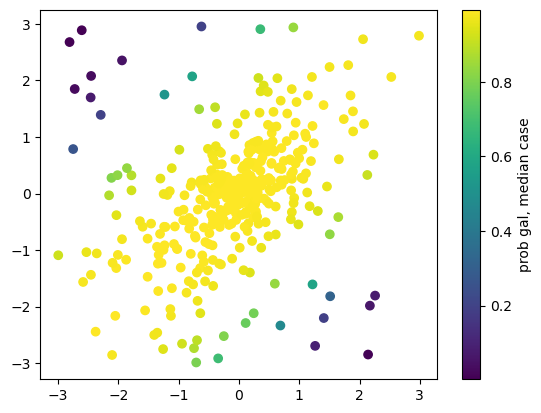

In [153]:
medians = [dynesty.utils.quantile(ss, .5, weights=dsampler.results.importance_weights())[0] for ss in dsampler.results.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

plt.close(); fig

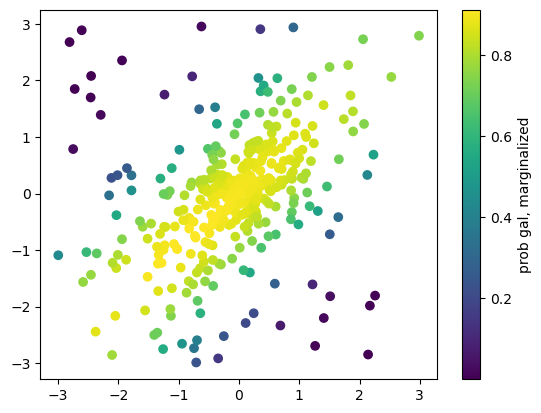

In [154]:
# this could be saved as a glob in production to speed things up at the cost of a bit of memory
lgbs = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in dsampler.results.samples])
llf, llb = lgbs.transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=dsampler.results.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pgal/(pgal + pbkg))
cb = plt.colorbar().set_label('prob gal, marginalized')

plt.close(); fig

They're almost indistinguishable, so use the first one for speed, although maybe later save the globs.

# Strong prior on Re

In [159]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.uniform(scale=1e-3, loc=1-1e-3/2),
    'n':stats.uniform(loc=.75, scale=1.25),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.99),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(40))
truths = [0, 0, 1, 1.25, 0.5, 40, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

18278it [01:20, 226.79it/s, batch: 5 | bound: 19 | nc: 1 | ncall: 440452 | eff(%):  4.031 | loglstar: -1017.358 < -1010.986 < -1013.073 | logz: -1026.248 +/-  0.108 | stop:  0.847]      


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


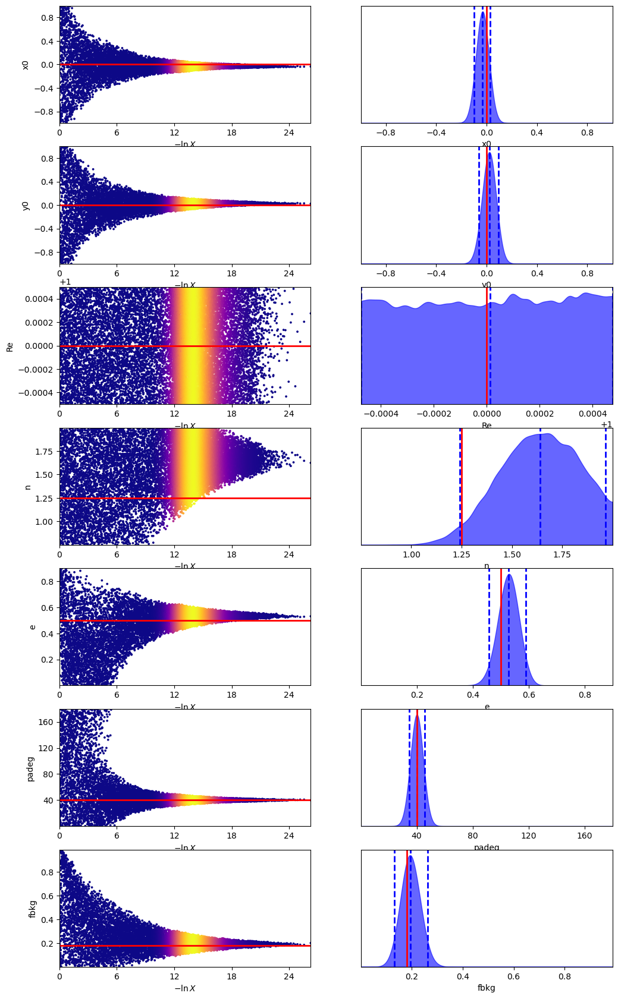

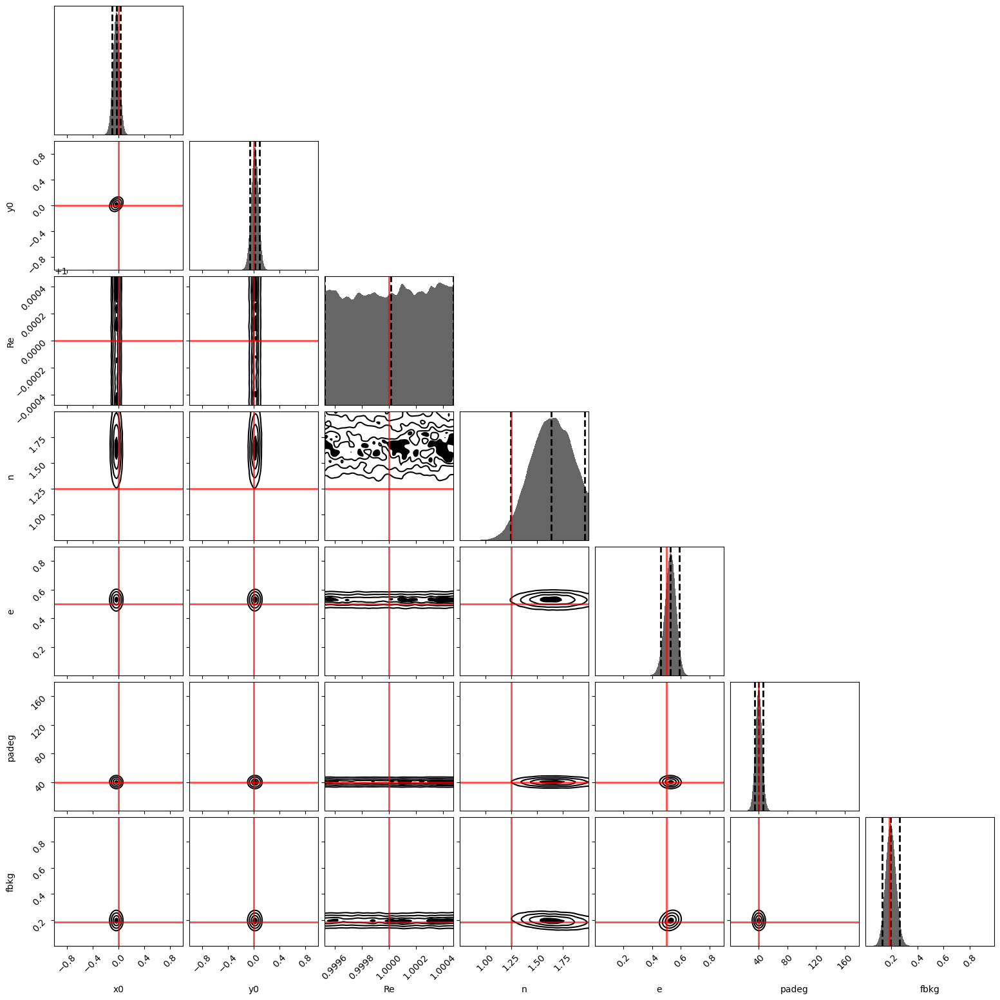

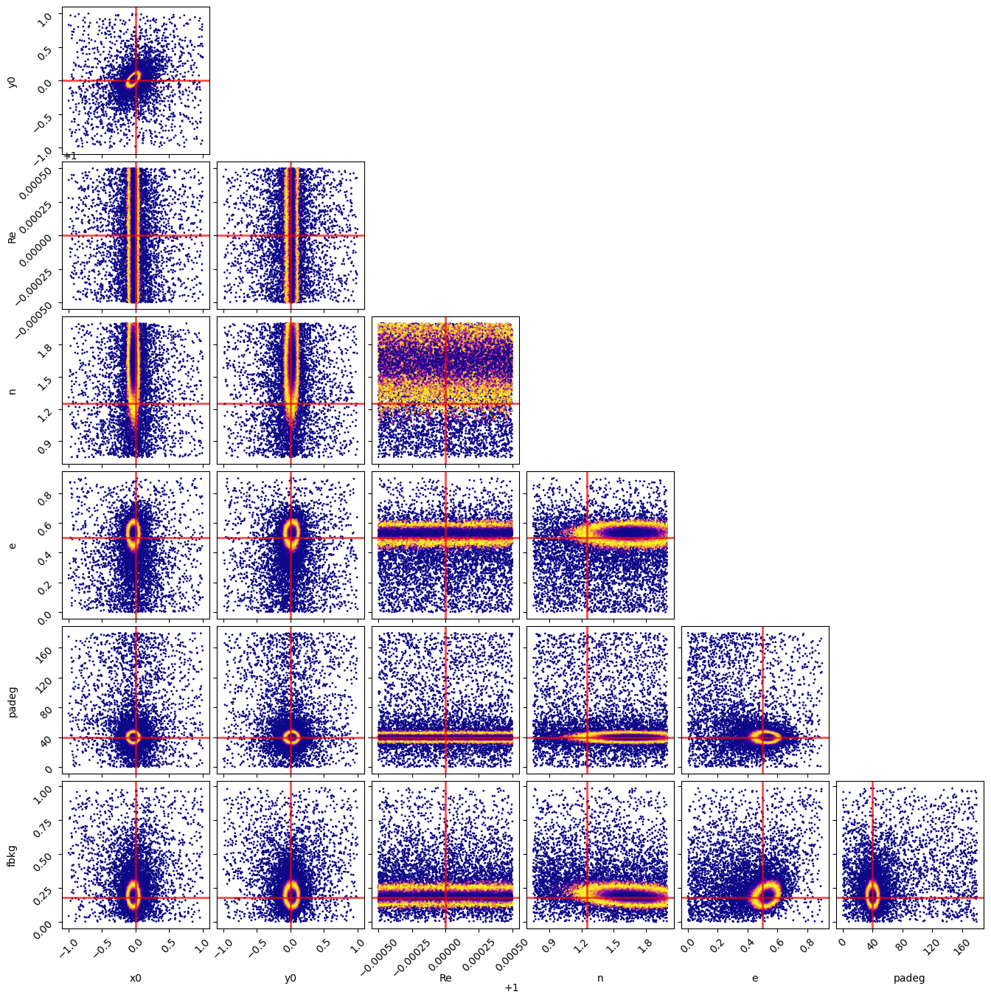

In [160]:
fig, axes = dyplot.runplot(res)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(res, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(res, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(res, labels=param_names, truths=truths)
display(fig)

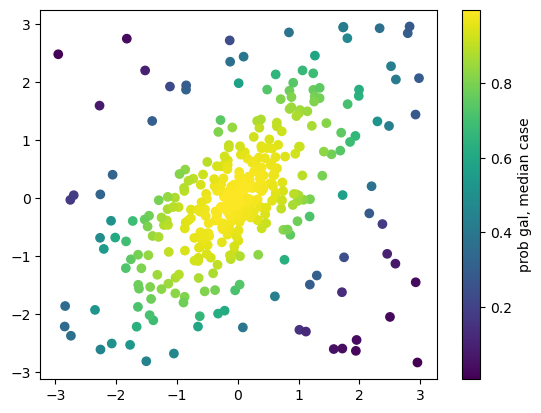

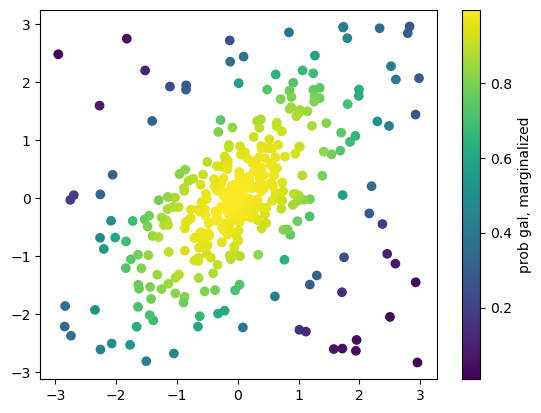

In [166]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Weaker prior on Re

In [178]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.uniform(scale=1, loc=1-.5),
    'n':stats.uniform(loc=.75, scale=1.25),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.99),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(40))
truths = [0, 0, 1, 1.25, 0.5, 40, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

18853it [01:22, 227.70it/s, batch: 4 | bound: 29 | nc: 1 | ncall: 456826 | eff(%):  4.013 | loglstar: -946.289 < -939.323 < -941.176 | logz: -958.348 +/-  0.138 | stop:  0.917]        


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


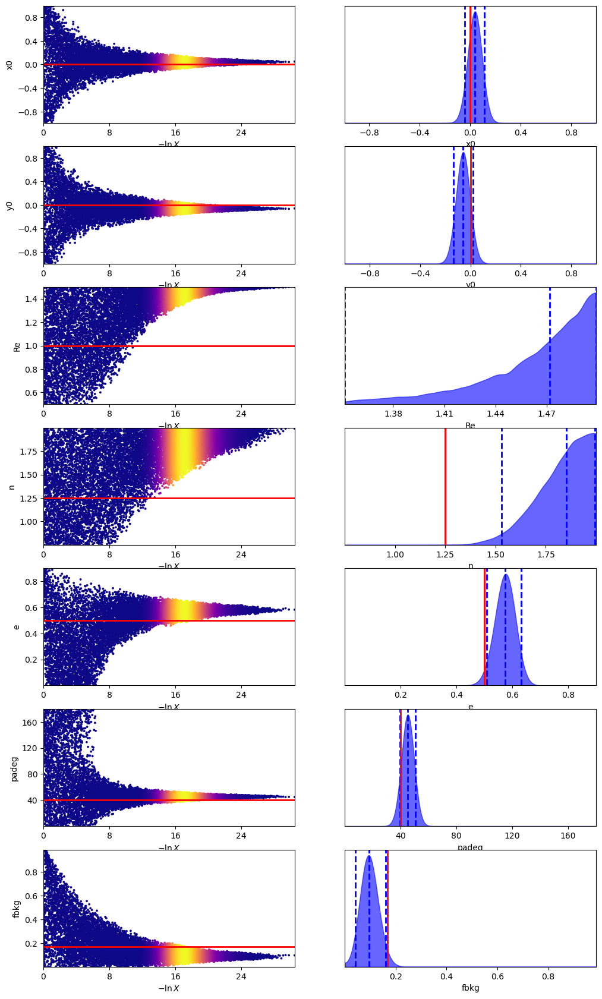

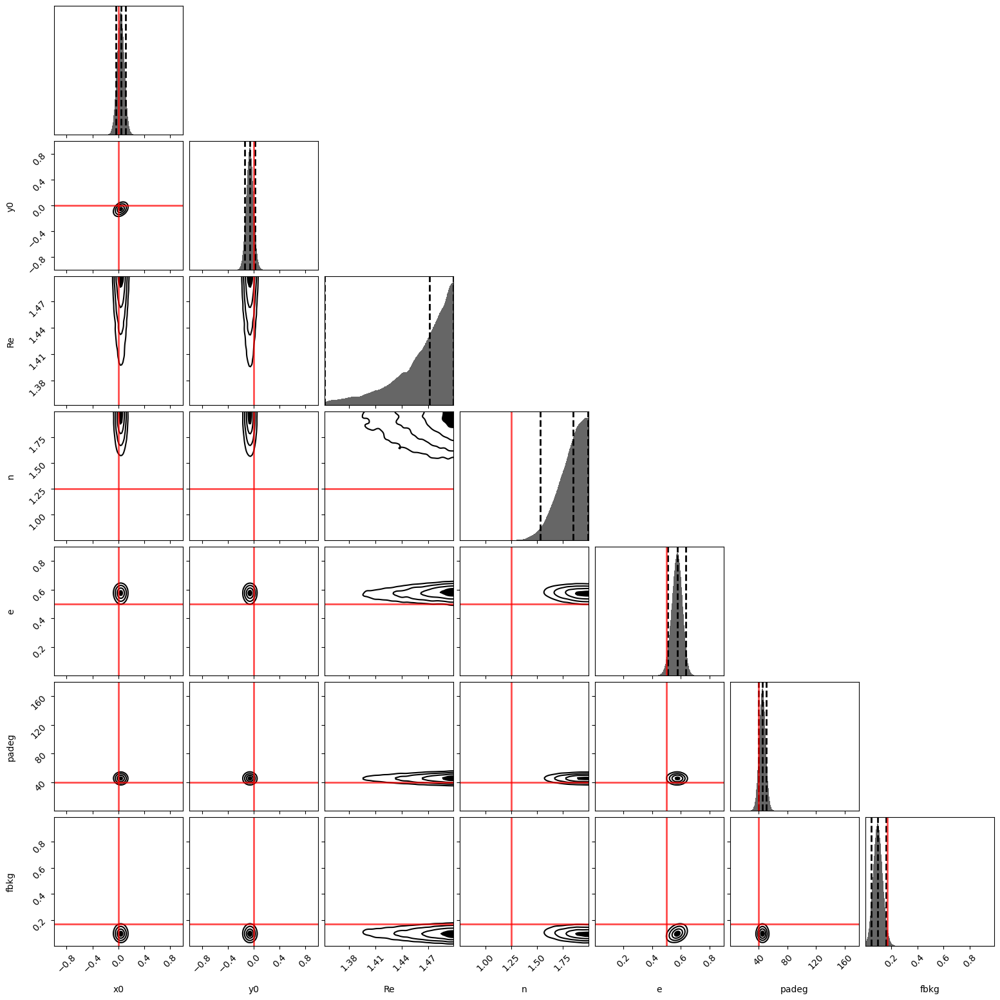

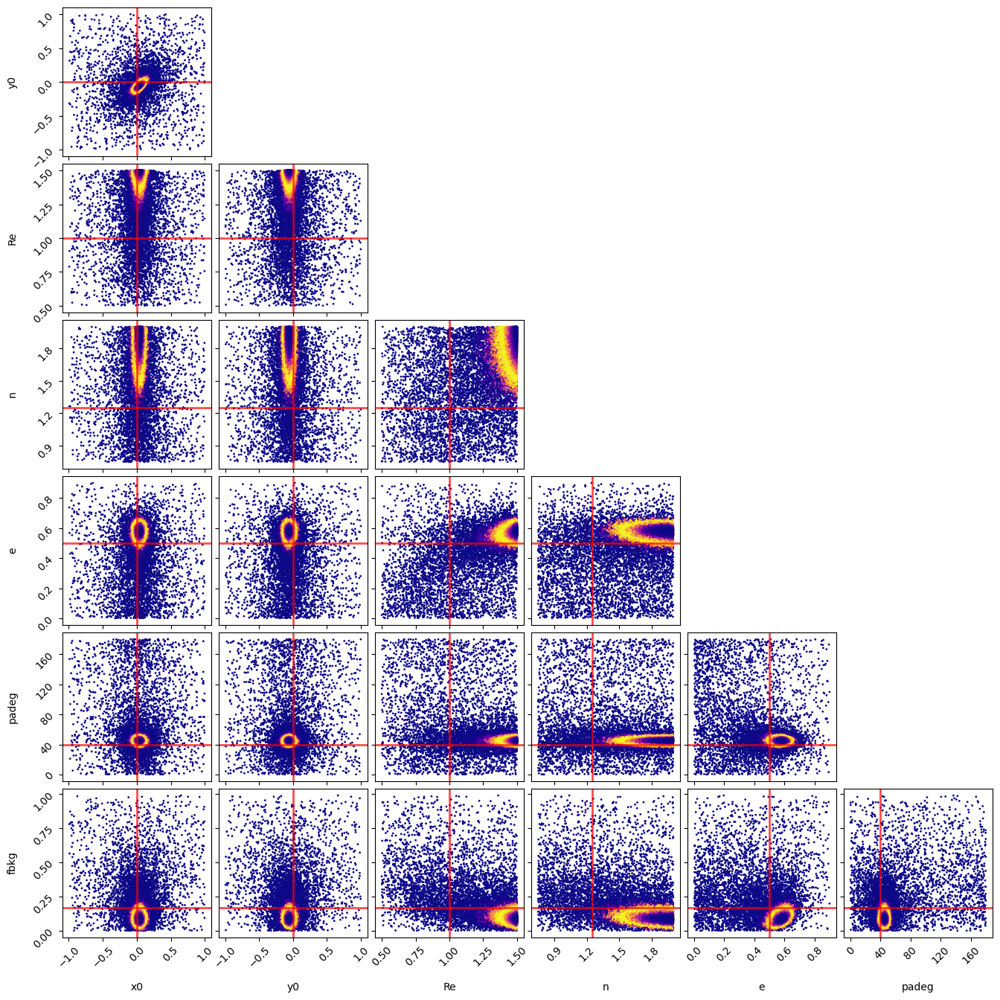

In [179]:
fig, axes = dyplot.runplot(res)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(res, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(res, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(res, labels=param_names, truths=truths)
display(fig)

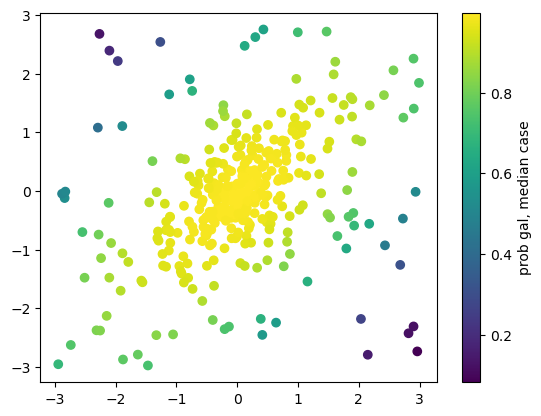

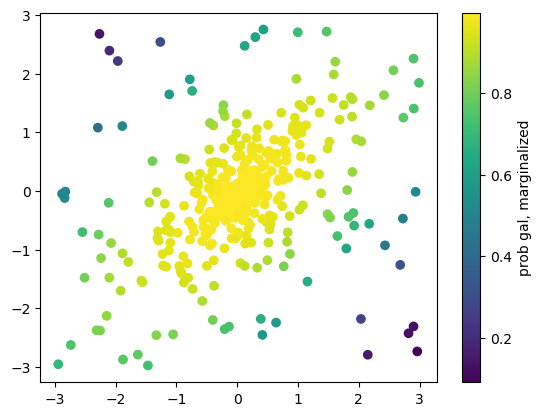

In [180]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Strongish prior on fbkg

In [175]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.reciprocal(.1, 5),
    'n':stats.uniform(loc=.75, scale=1.25),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.truncnorm(loc=.2, scale=.02, a=-2/.02, b=(1-.2)/.02),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(40))
truths = [0, 0, 1, 1.25, 0.5, 40, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

22359it [01:32, 242.04it/s, batch: 3 | bound: 6 | nc: 1 | ncall: 553336 | eff(%):  3.948 | loglstar: -889.999 < -883.309 < -888.860 | logz: -908.608 +/-  0.175 | stop:  0.965]         


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


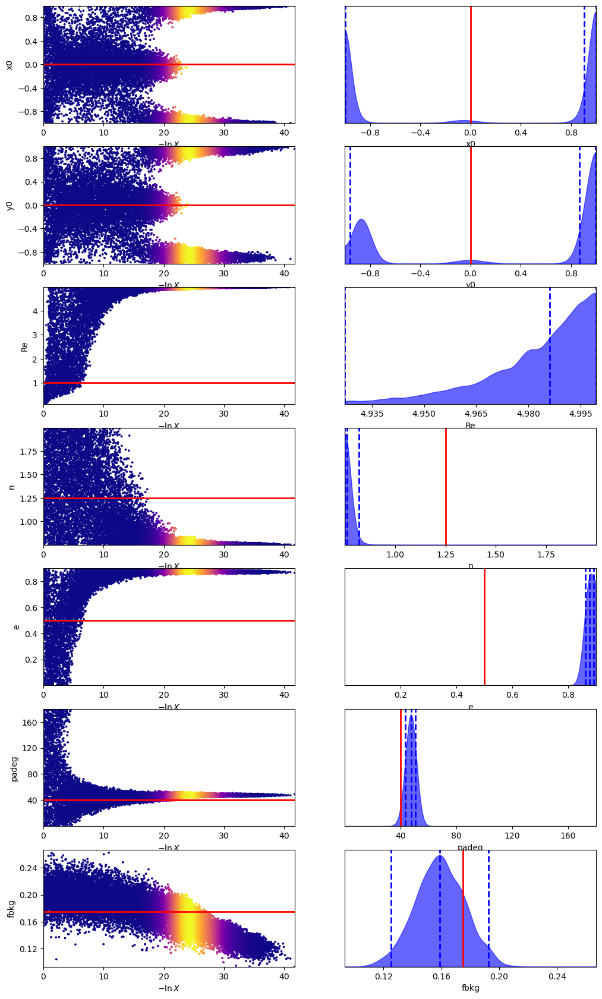

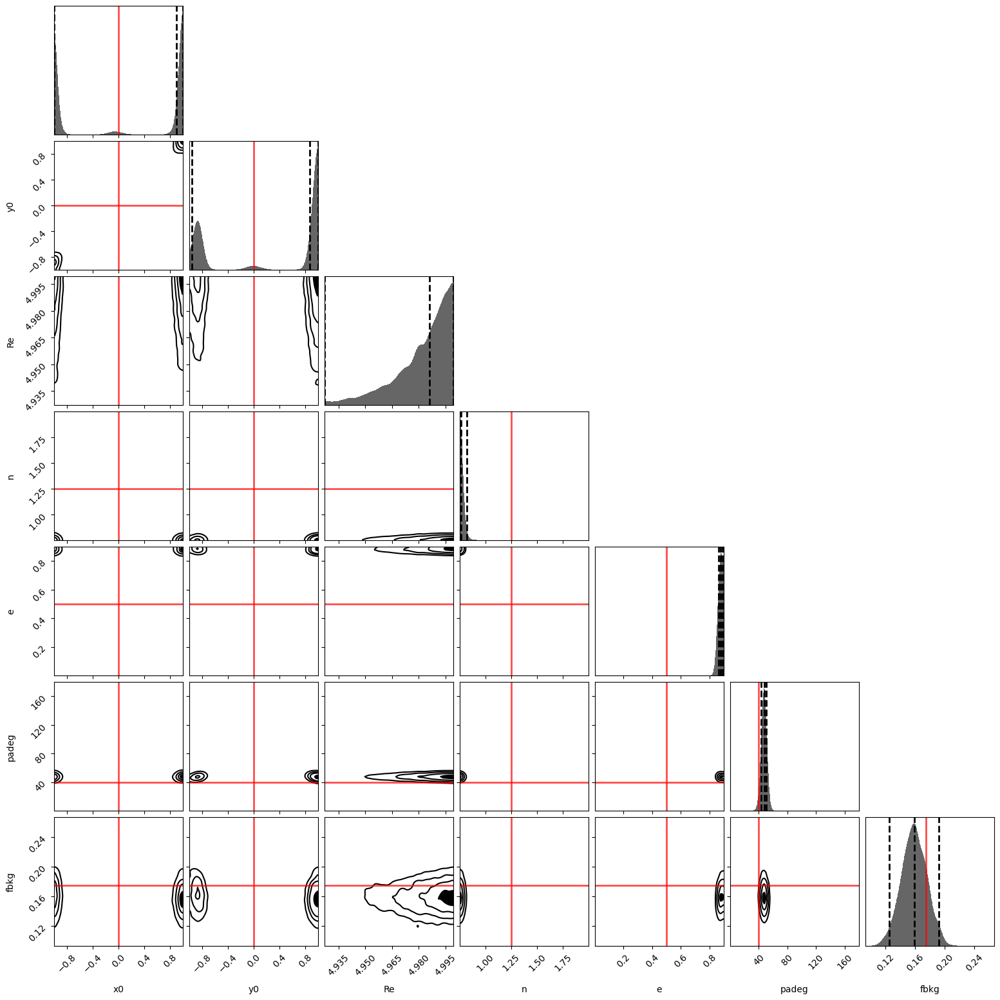

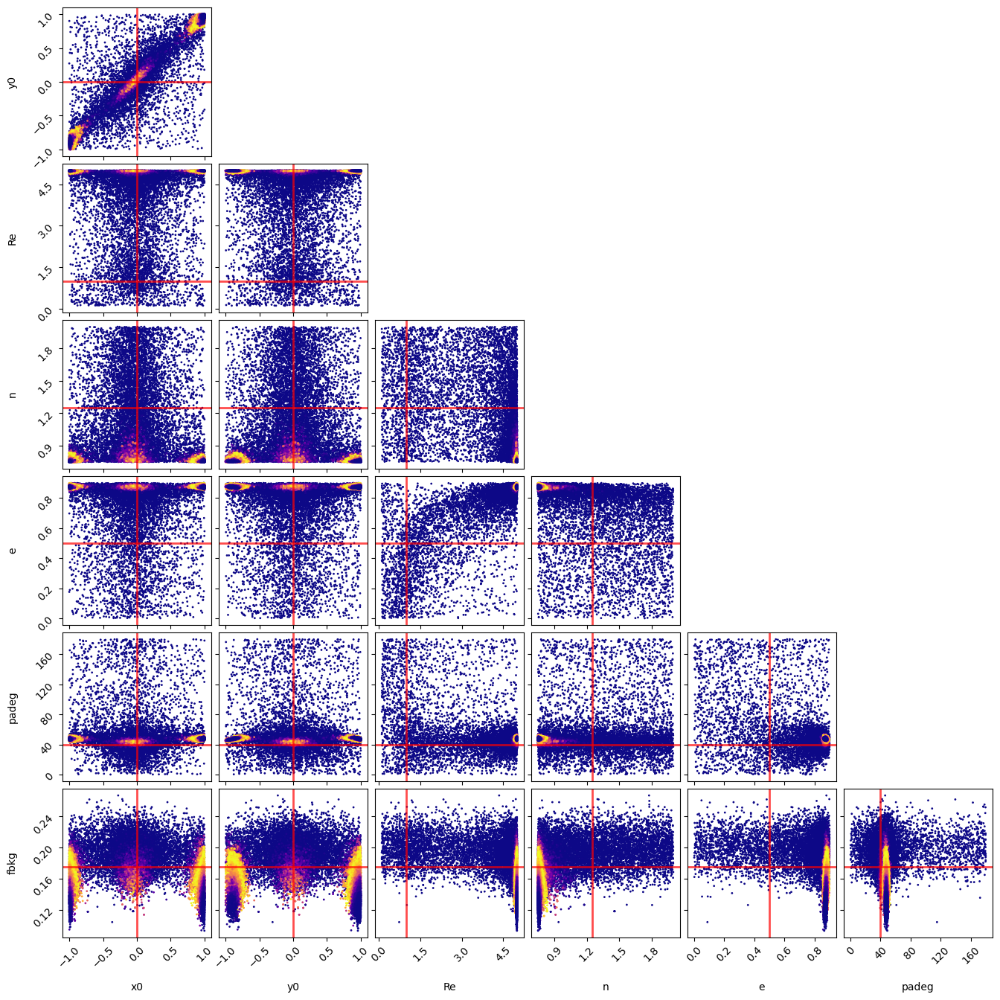

In [176]:
fig, axes = dyplot.runplot(res)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(res, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(res, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(res, labels=param_names, truths=truths)
display(fig)

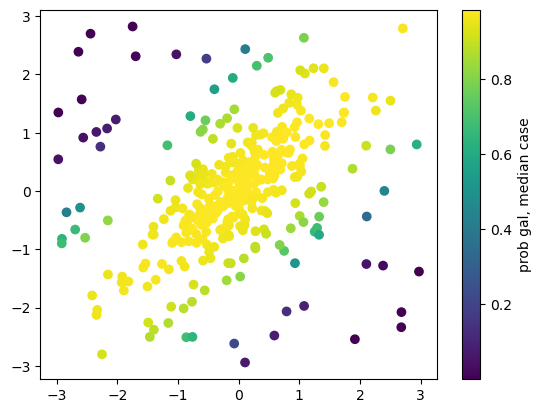

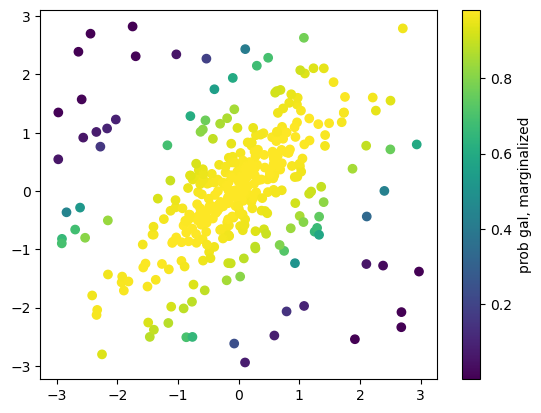

In [177]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Strong prior on n

In [182]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.reciprocal(.1, 5),
    'n':stats.uniform(loc=1.2, scale=.1),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.99),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(40))
truths = [0, 0, 1, 1.25, 0.5, 40, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

20292it [01:24, 241.01it/s, batch: 5 | bound: 30 | nc: 1 | ncall: 496186 | eff(%):  3.985 | loglstar: -890.460 < -883.925 < -885.269 | logz: -905.487 +/-  0.147 | stop:  0.931]        


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


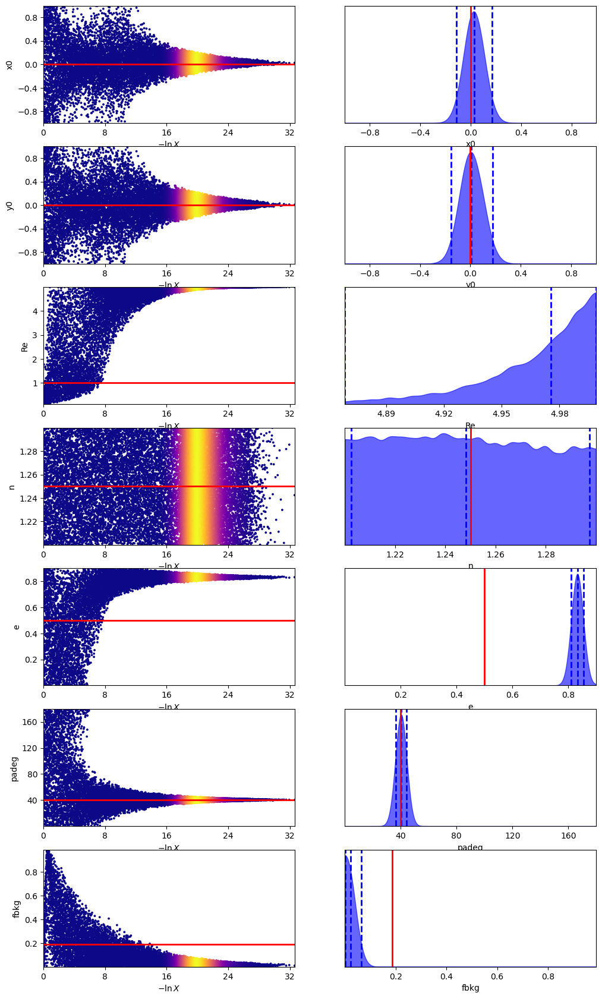

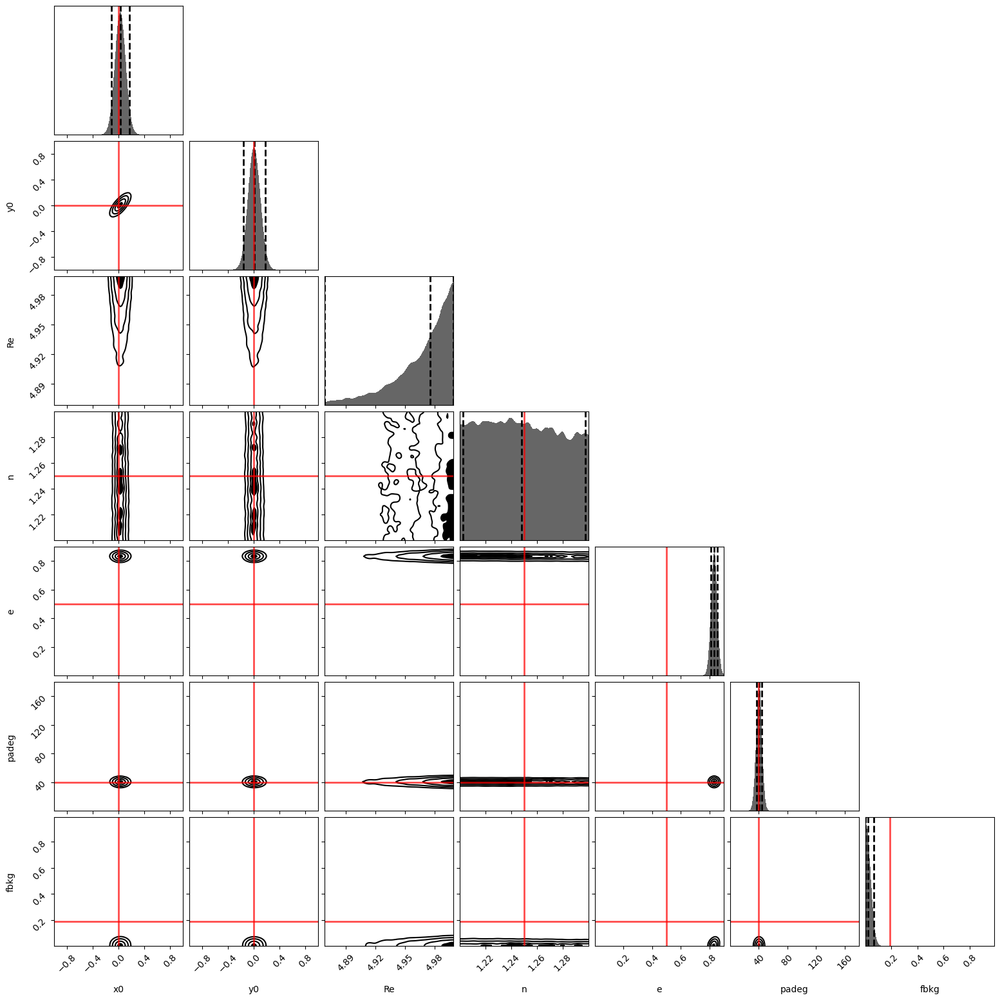

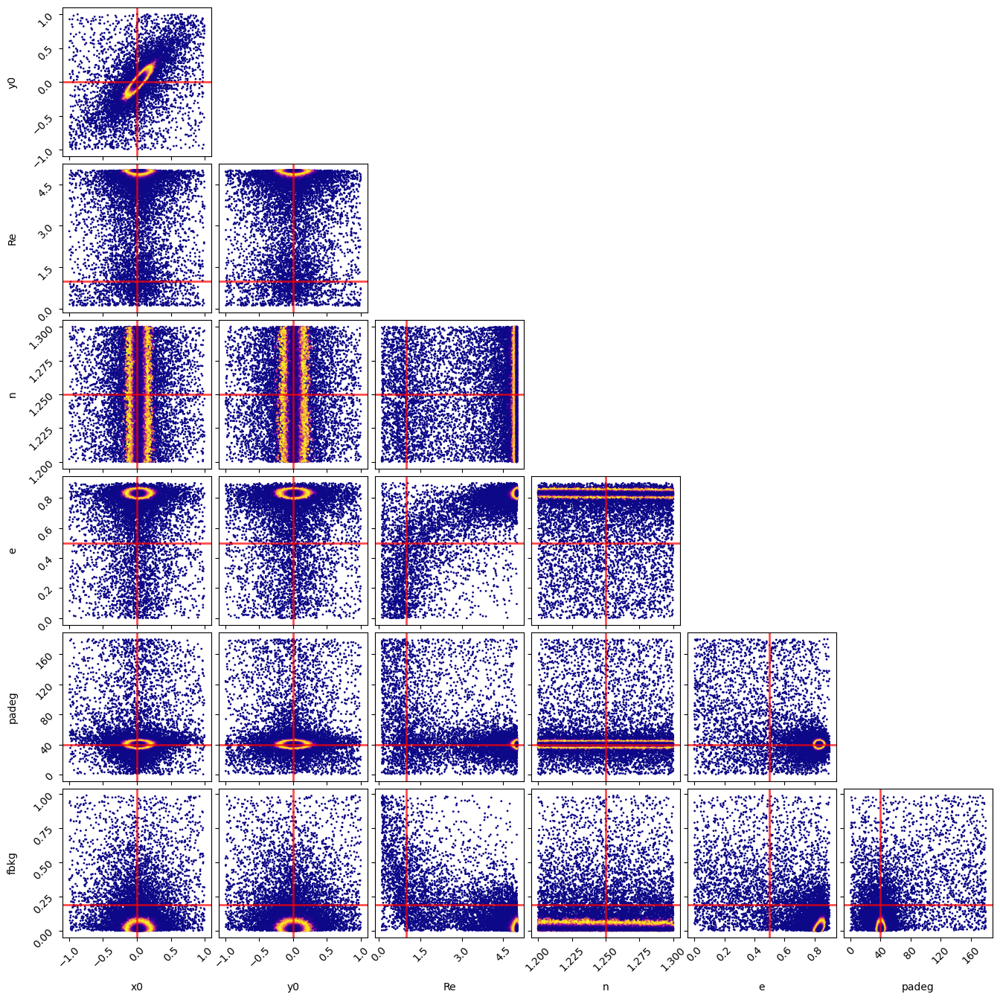

In [190]:
fig, axes = dyplot.runplot(dsampler.results)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(dsampler.results, labels=param_names, truths=truths)
display(fig)

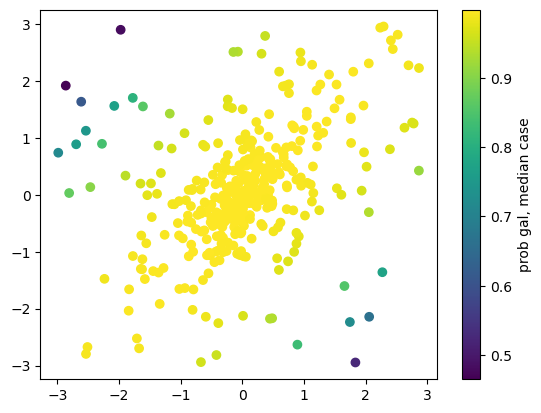

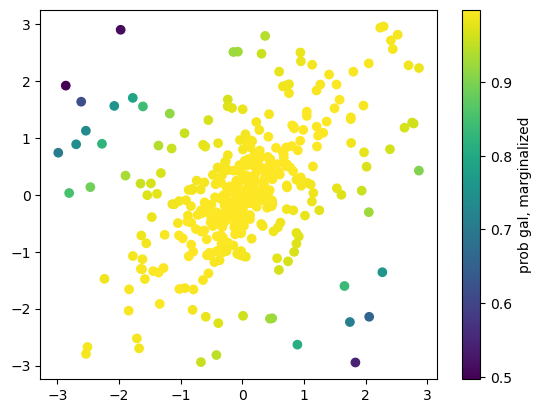

In [191]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Strong prior on e

In [192]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.reciprocal(.1, 5),
    'n':stats.uniform(loc=.75, scale=1.25),
    'e':stats.uniform(loc=.48, scale=.04),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.99),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(40))
truths = [0, 0, 1, 1.25, 0.5, 40, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

18826it [01:17, 244.12it/s, batch: 4 | bound: 23 | nc: 1 | ncall: 454996 | eff(%):  4.023 | loglstar: -984.130 < -976.438 < -979.595 | logz: -995.801 +/-  0.138 | stop:  0.911]        


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


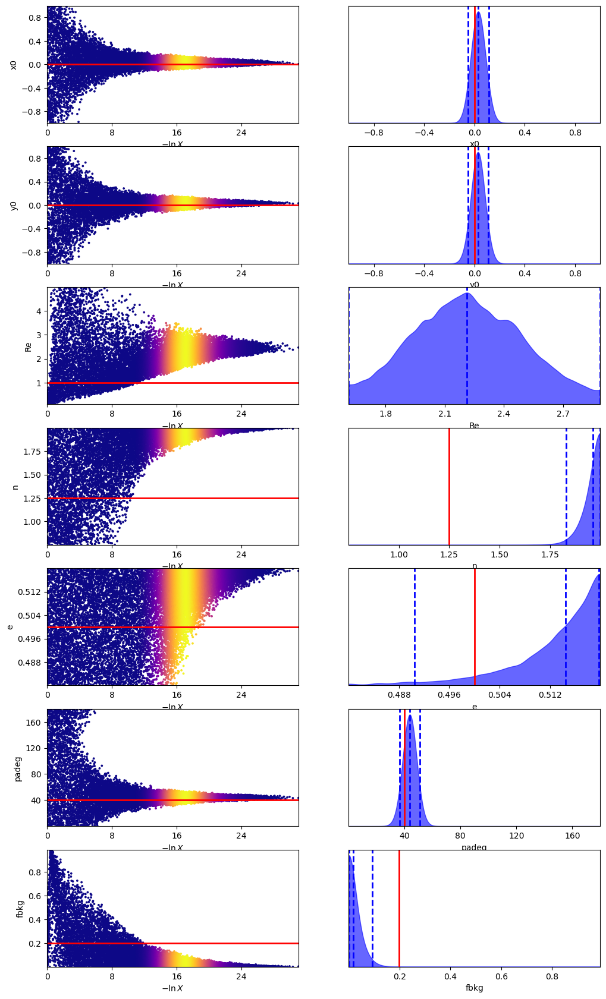

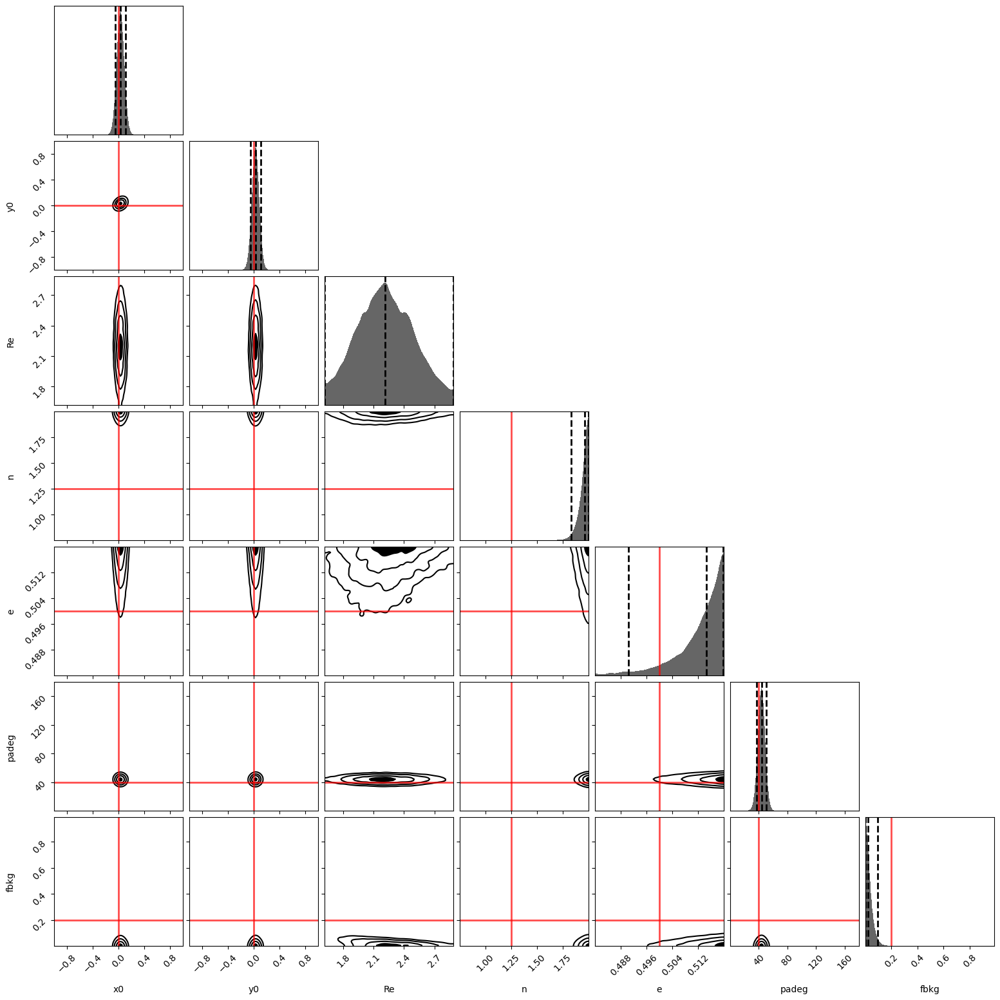

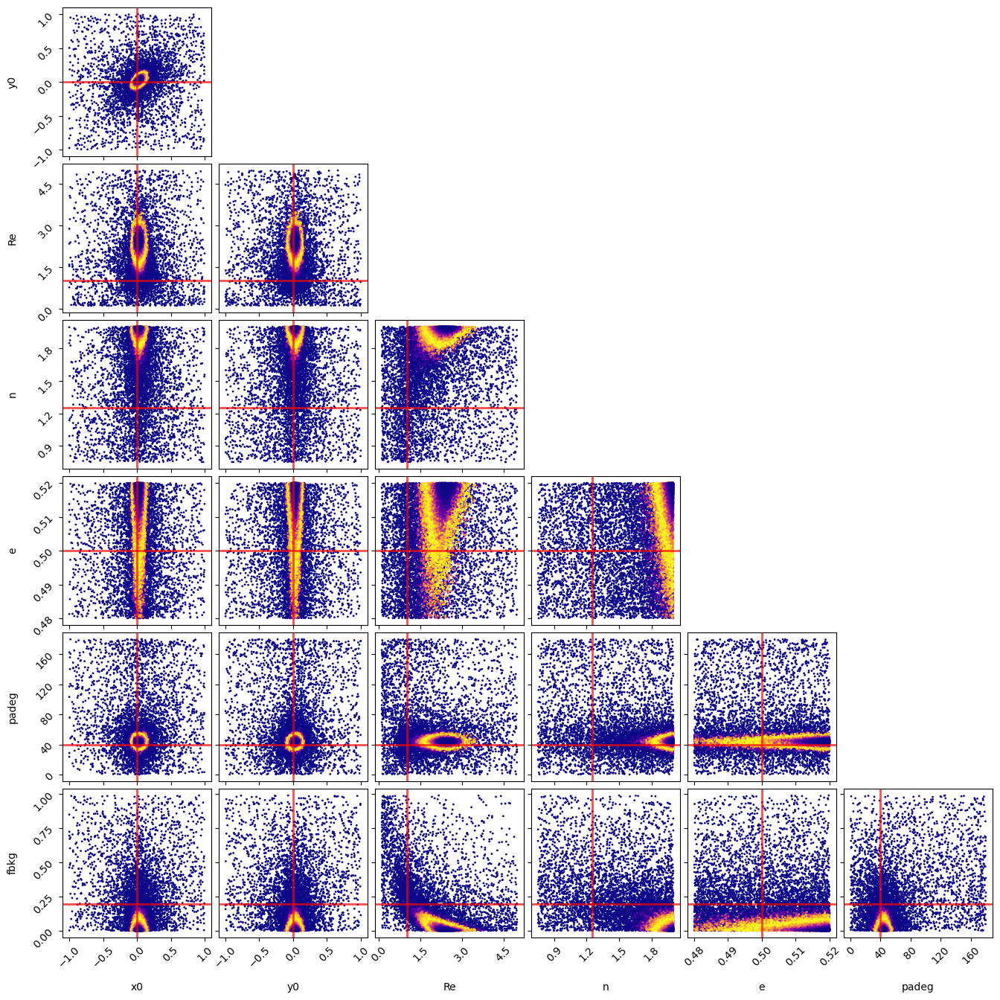

In [193]:
fig, axes = dyplot.runplot(dsampler.results)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(dsampler.results, labels=param_names, truths=truths)
display(fig)

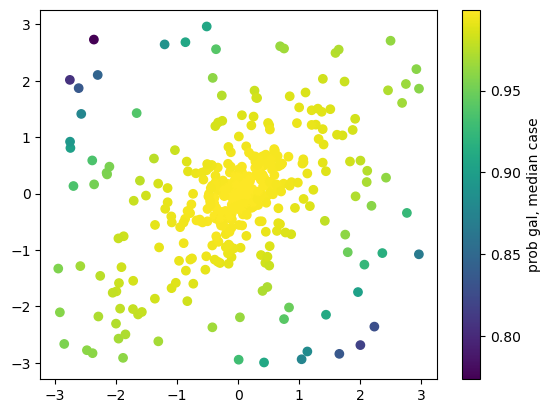

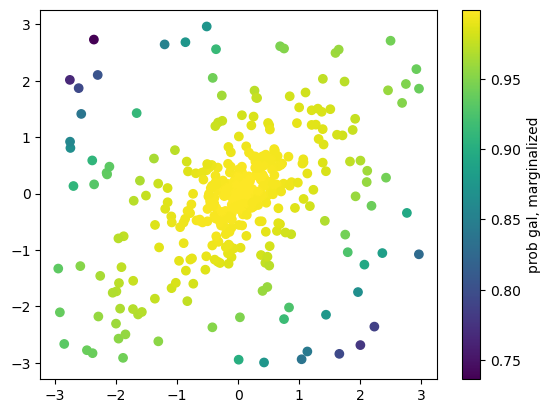

In [194]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Fiducial case, not aligned to rectangle...

In [195]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.reciprocal(.1, 5),
    'n':stats.uniform(loc=.75, scale=1.25),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.99),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(90))
truths = [0, 0, 1, 1.25, 0.5, 90, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

20889it [01:31, 229.54it/s, batch: 4 | bound: 33 | nc: 1 | ncall: 511957 | eff(%):  3.979 | loglstar: -899.941 < -892.753 < -894.472 | logz: -915.780 +/-  0.157 | stop:  0.902]        


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


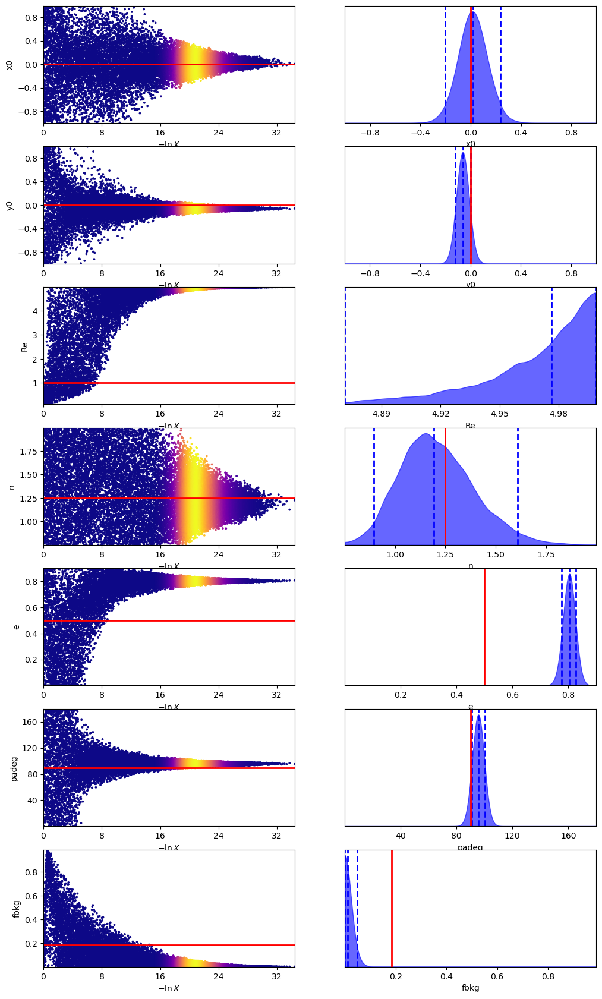

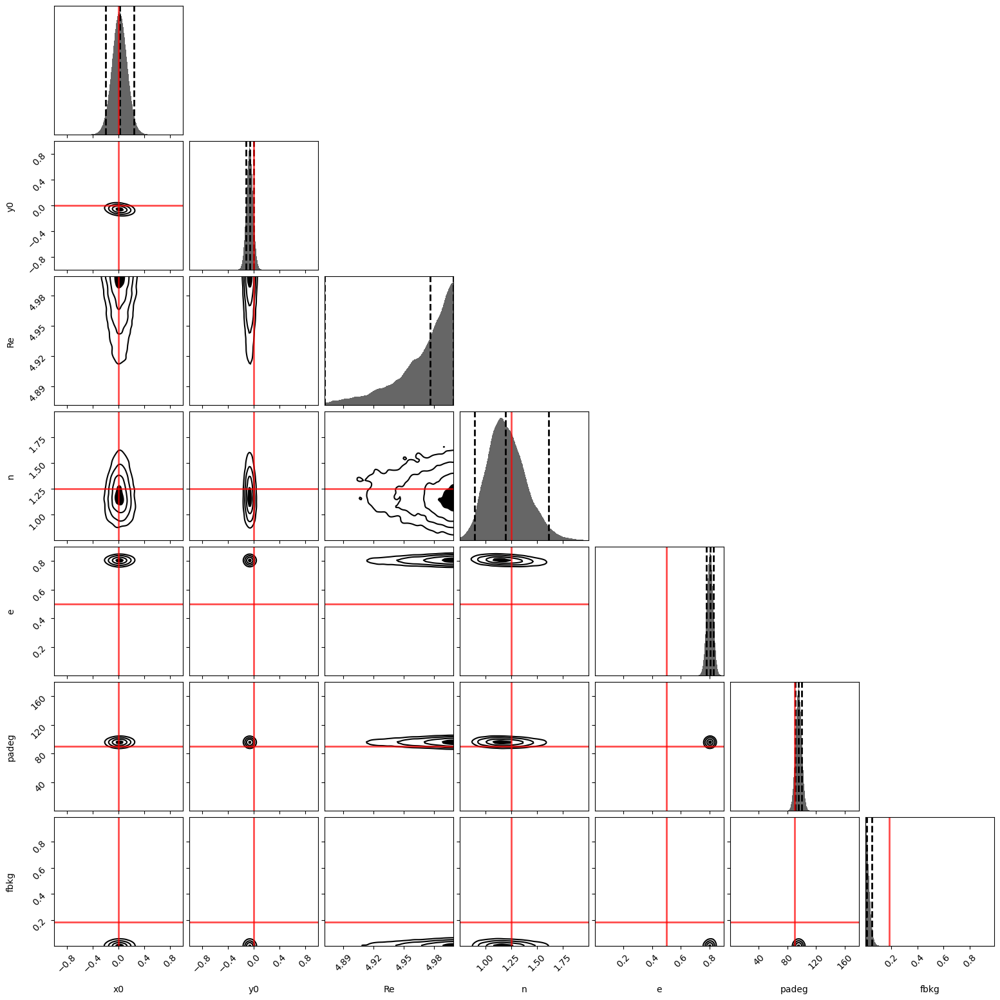

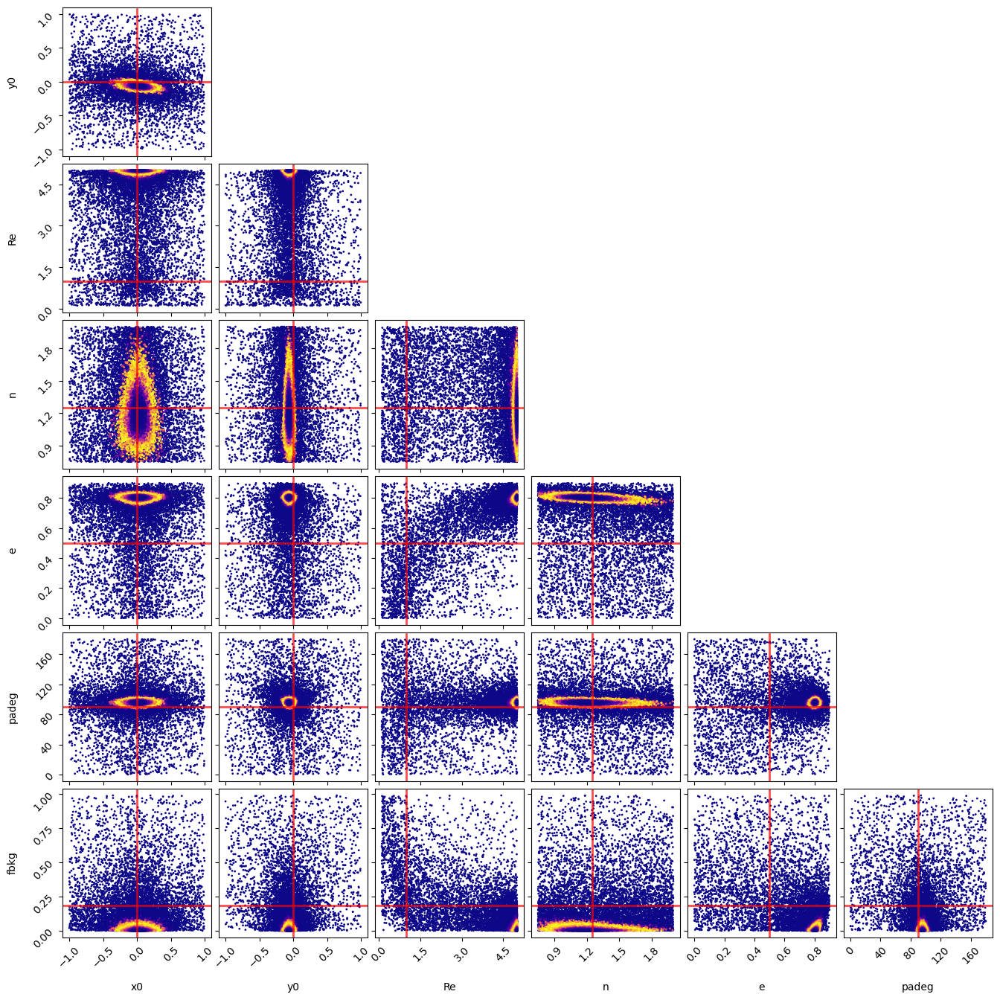

In [199]:
fig, axes = dyplot.runplot(dsampler.results)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(dsampler.results, labels=param_names, truths=truths)
display(fig)

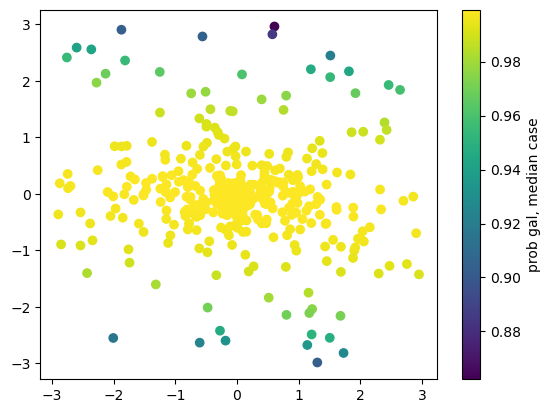

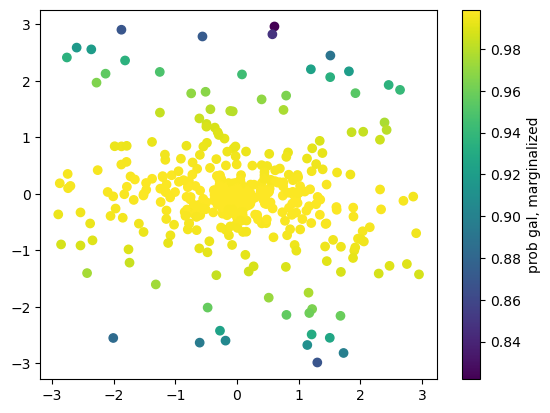

In [200]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Strong prior on Re, not aligned to rectangle

In [201]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.uniform(scale=1e-3, loc=1-1e-3/2),
    'n':stats.uniform(loc=.75, scale=1.25),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.99),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(90))
truths = [0, 0, 1, 1.25, 0.5, 90, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

17329it [01:15, 229.56it/s, batch: 5 | bound: 28 | nc: 1 | ncall: 415153 | eff(%):  4.047 | loglstar: -961.174 < -954.840 < -956.163 | logz: -971.015 +/-  0.124 | stop:  0.954]        


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


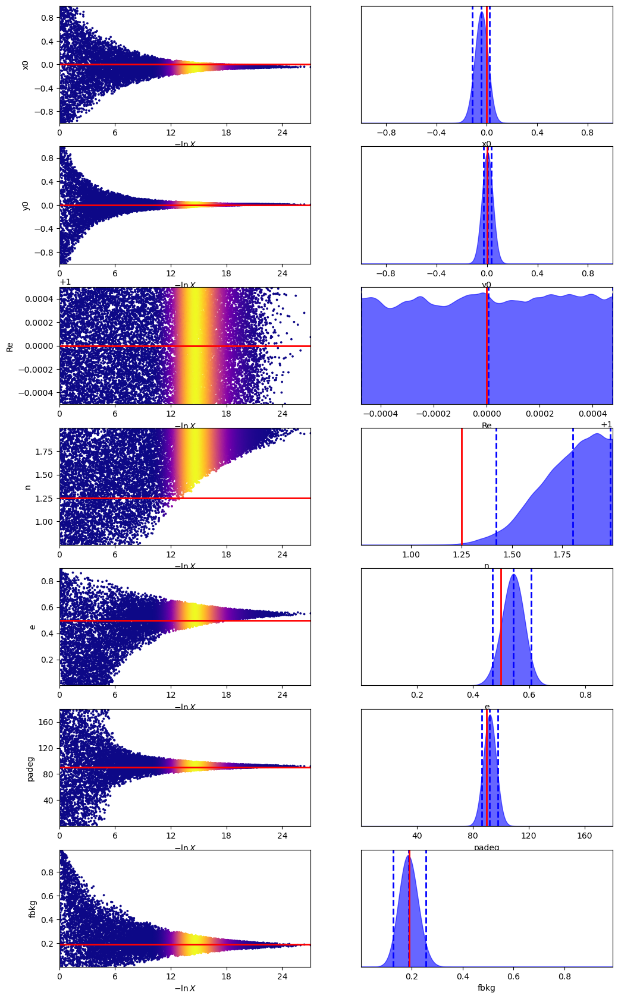

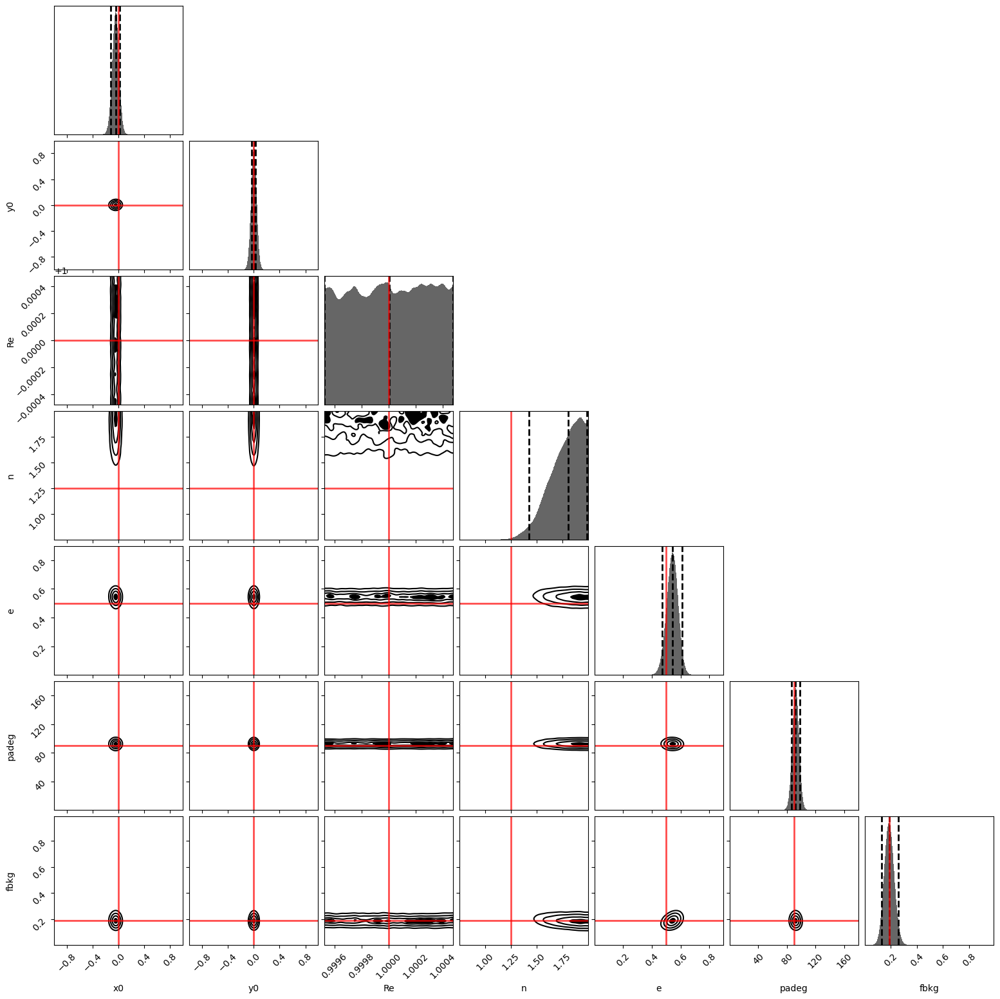

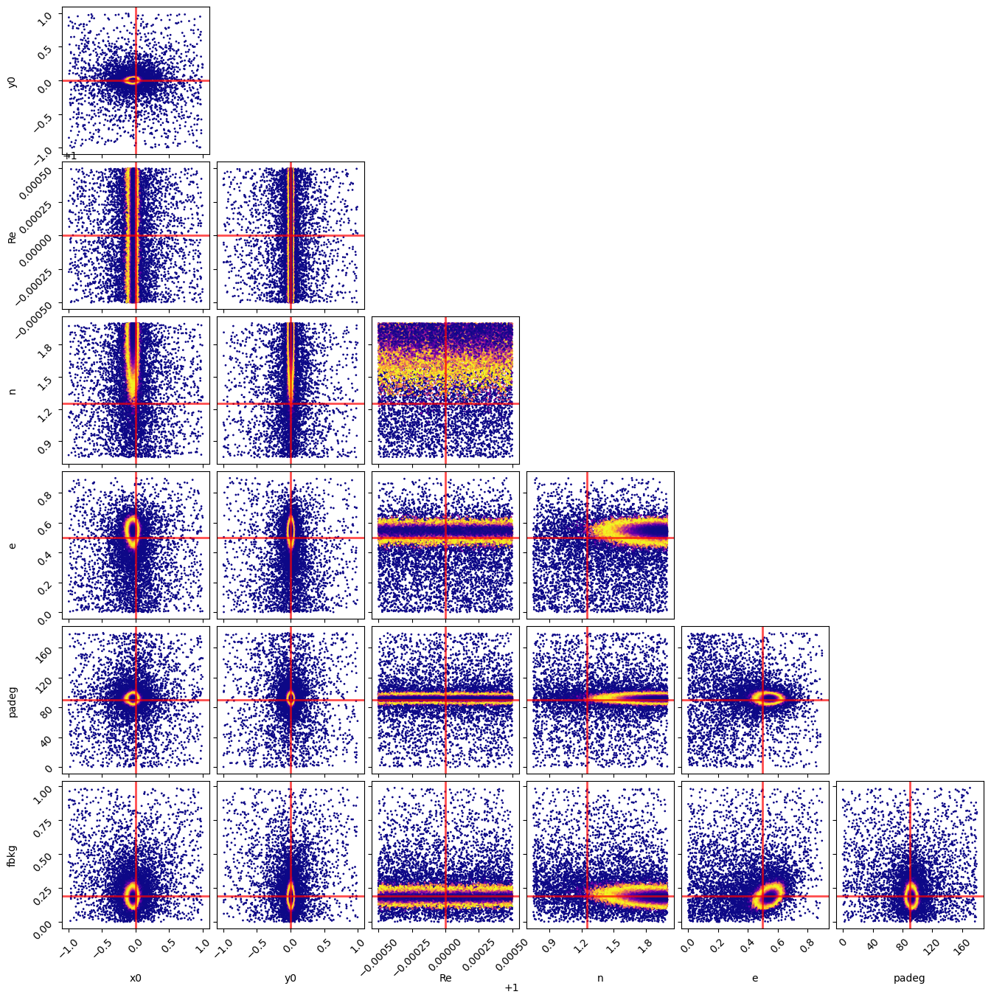

In [202]:
fig, axes = dyplot.runplot(dsampler.results)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(dsampler.results, labels=param_names, truths=truths)
display(fig)

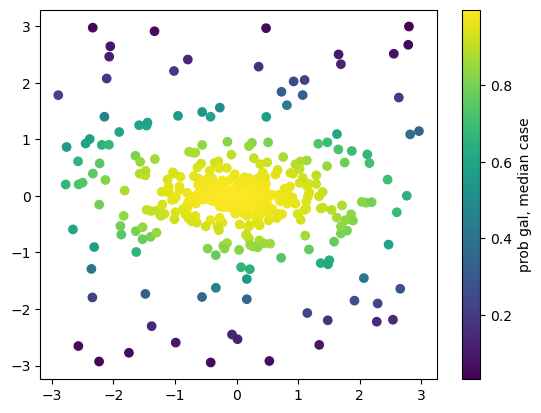

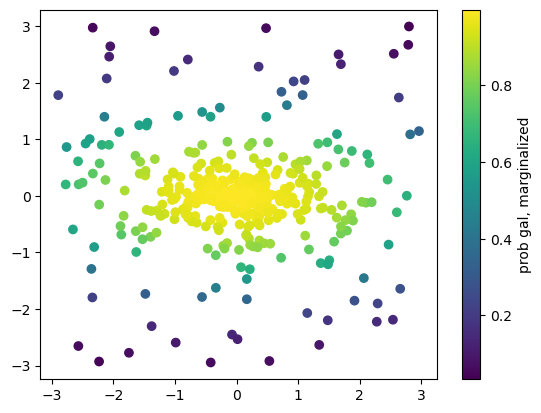

In [203]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Exponential case with strong n prior

In [220]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.reciprocal(.1, 5),
    'n':stats.uniform(loc=.95, scale=.1),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.8, loc=.1),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 2, test_region, e=.5, pa=math.radians(90), nsersic=1)
truths = [0, 0, 1, 1., 0.5, 90, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

20531it [01:22, 247.59it/s, batch: 4 | bound: 30 | nc: 1 | ncall: 501982 | eff(%):  3.987 | loglstar: -903.101 < -895.803 < -897.915 | logz: -918.857 +/-  0.155 | stop:  0.929]        


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


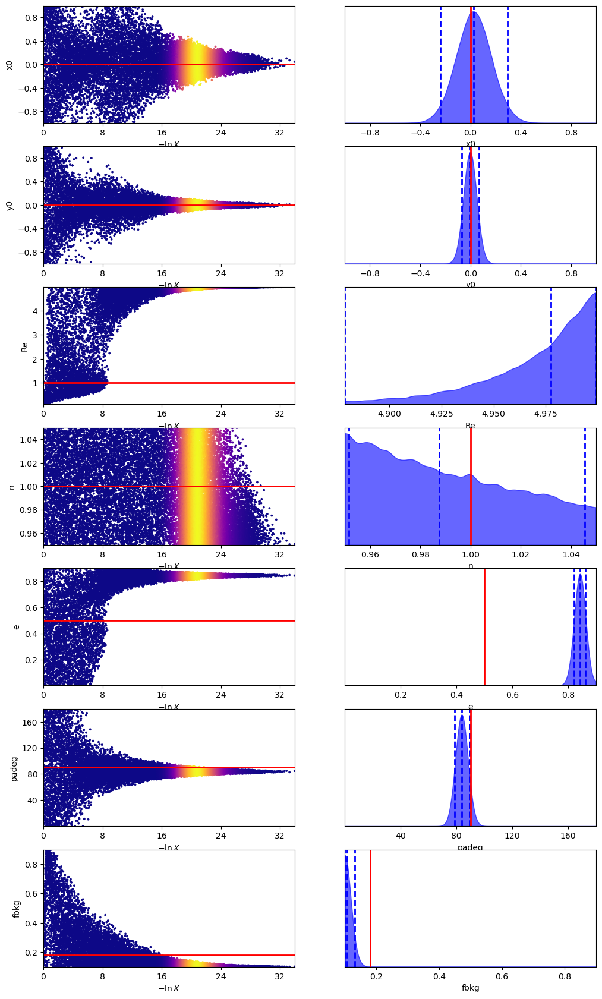

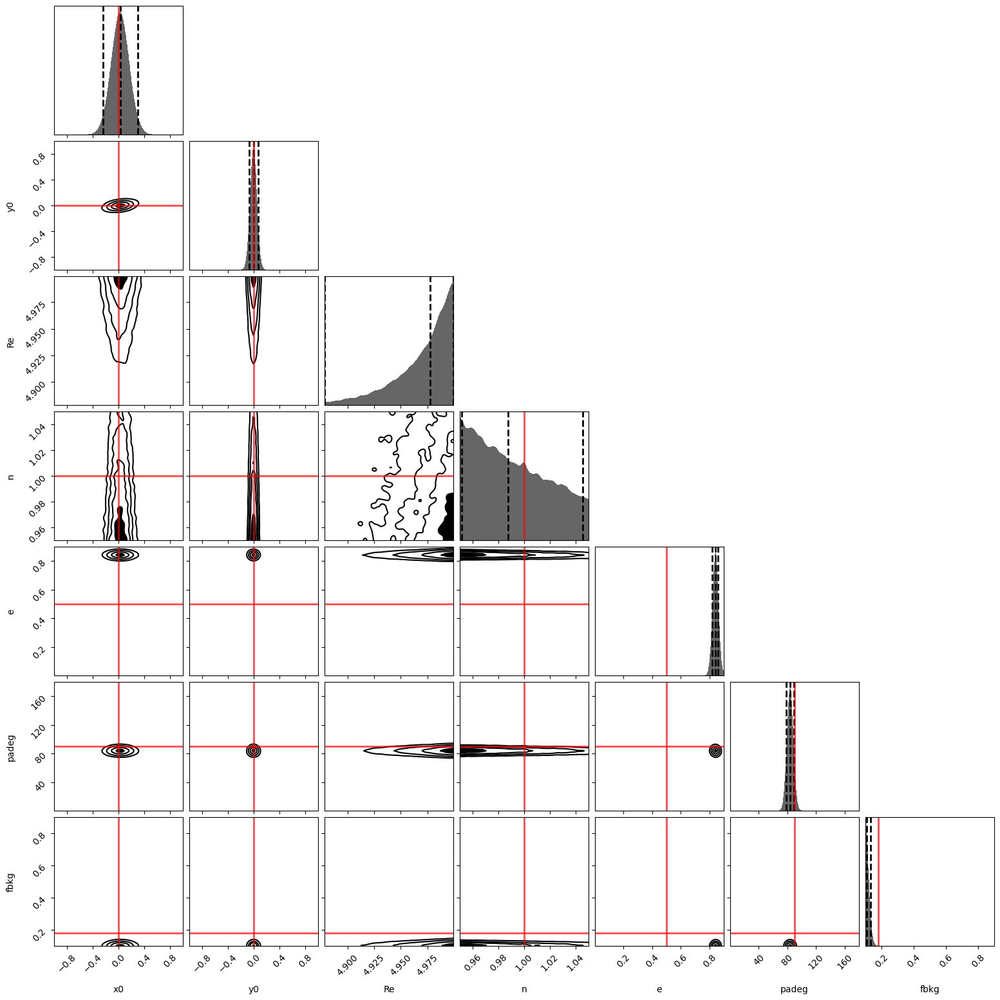

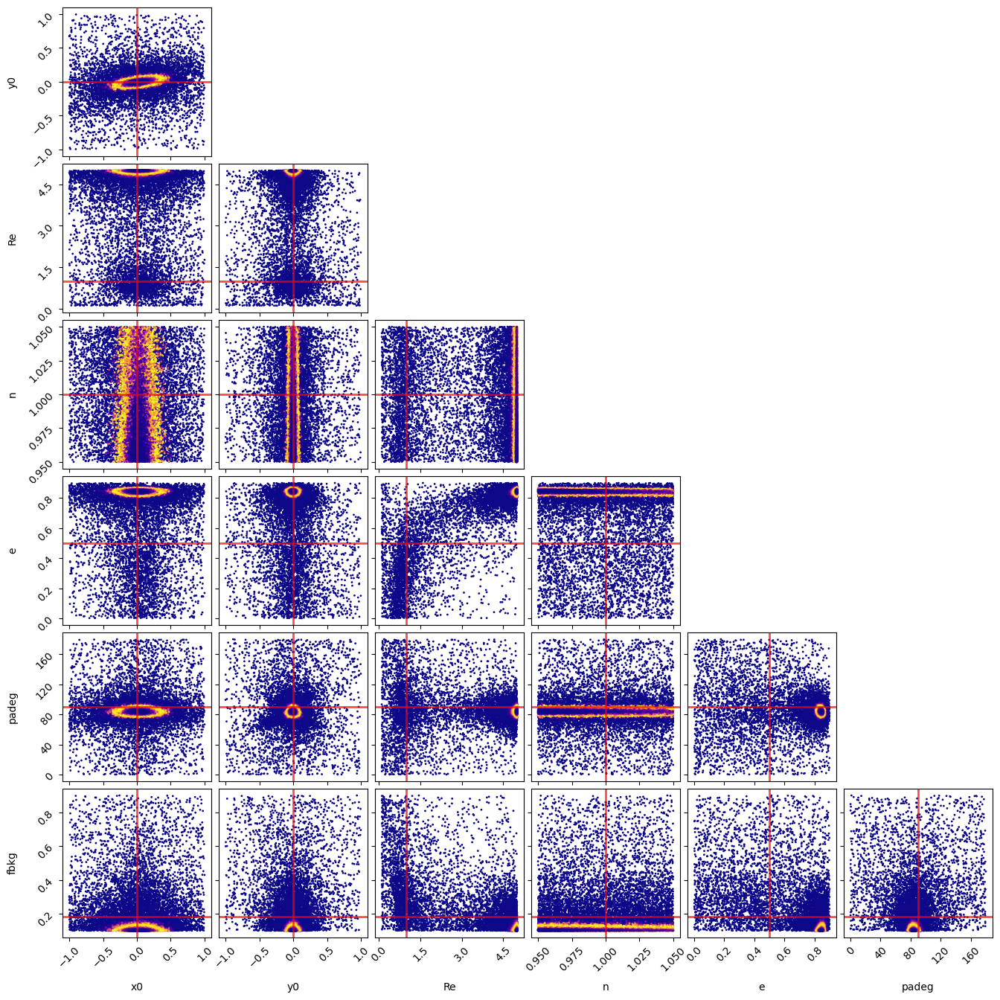

In [221]:
fig, axes = dyplot.runplot(dsampler.results)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(dsampler.results, labels=param_names, truths=truths)
display(fig)

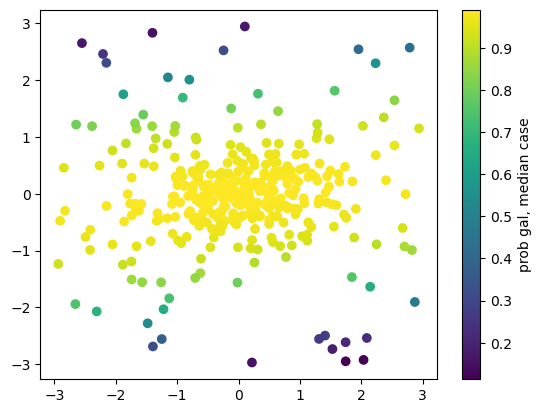

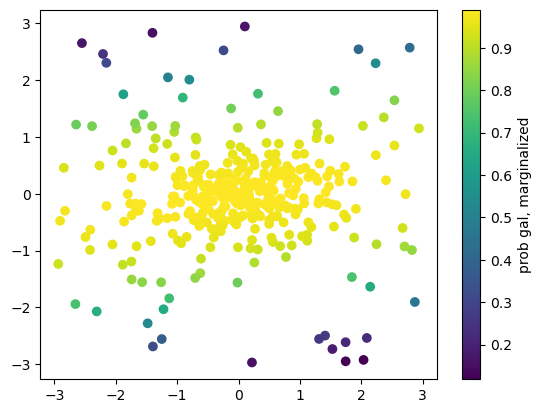

In [222]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Exponential but more background

In [223]:
test_region = rectangular_small_reg

prior_distributions = {
    'x0':stats.uniform(loc=-1, scale=2),
    'y0':stats.uniform(loc=-1, scale=2),
    'Re':stats.reciprocal(.1, 5),
    'n':stats.uniform(loc=.95, scale=.1),
    'e':stats.uniform(scale=.9),
    'padeg': stats.uniform(scale=180),
    'fbkg':stats.uniform(scale=.8, loc=.1),
}
prior_distributions_ppf_list = [prior_distributions[nm].ppf for nm in param_names]

test_data, tg, tb = glx_and_uniform(50, 10, test_region, e=.5, pa=math.radians(90), nsersic=1)
truths = [0, 0, 1, 1., 0.5, 90, len(tb[0])/(len(tb[0]) + len(tg[0]))]

with np.errstate(invalid='ignore'):
    with dynesty.pool.Pool(njobs, loglike, stats_prior_transform_f,
                                logl_kwargs={'data': test_data, 'region':test_region},
                                ptform_kwargs={'distrsufuncs': prior_distributions_ppf_list}
                    ) as pool:
        dsampler = dynesty.DynamicNestedSampler(pool.loglike, pool.prior_transform, pool=pool,
                                                ndim=len(param_names),sample='rwalk')
        dsampler.run_nested(maxiter=100000,  wt_kwargs={'pfrac': 1.0})
res = dsampler.results

22834it [01:36, 237.30it/s, batch: 5 | bound: 39 | nc: 1 | ncall: 566443 | eff(%):  3.941 | loglstar: -1943.302 < -1935.206 < -1937.004 | logz: -1959.557 +/-  0.155 | stop:  0.796]      


/Users/etollerud/src/structparams_inference_biases/.pixi/envs/default/lib/python3.12/site-packages/dynesty/plotting.py:318: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axes[i].set_ylim([ymin, ymax])


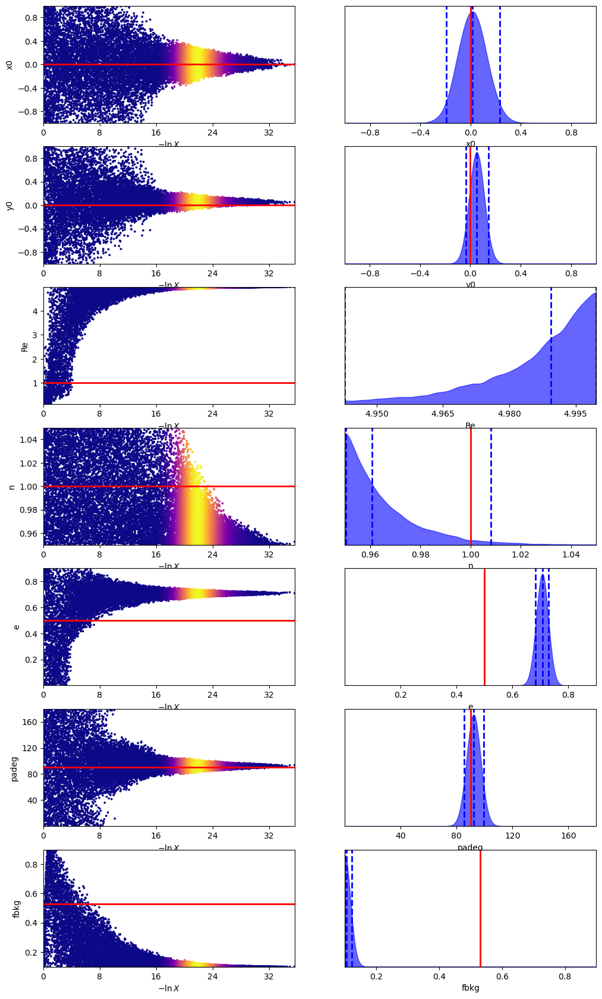

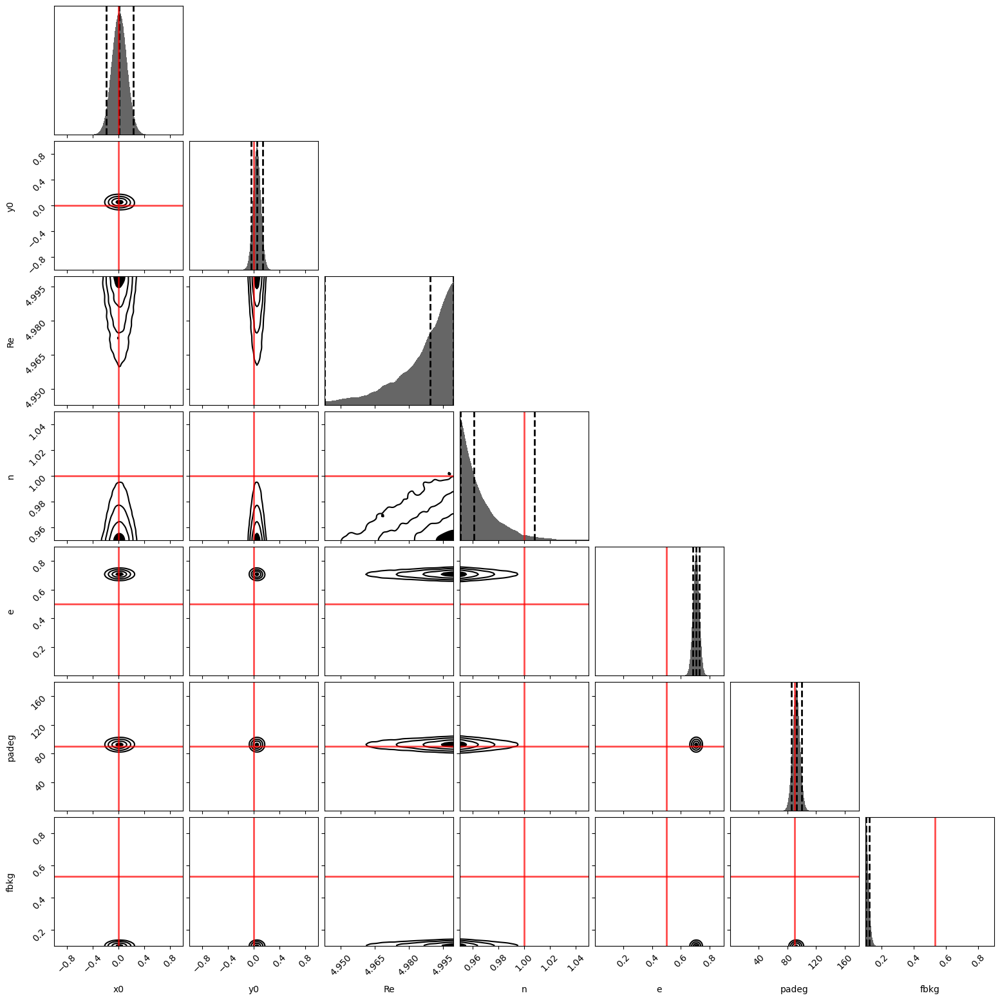

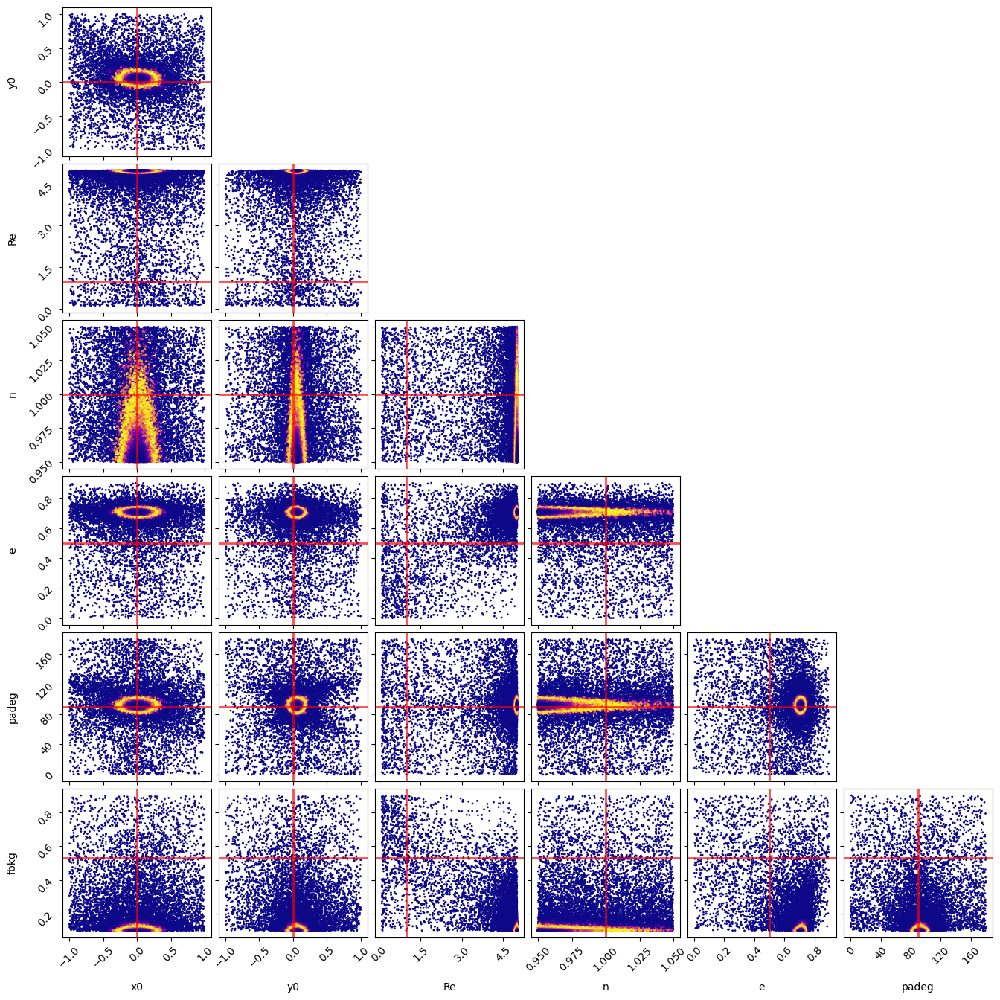

In [224]:
fig, axes = dyplot.runplot(dsampler.results)

span = [1,1, .95, 1, 1, 1, 1]

fig, axes = dyplot.traceplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerplot(dsampler.results, labels=param_names, truths=truths, span=span)
display(fig)
fig, axes = dyplot.cornerpoints(dsampler.results, labels=param_names, truths=truths)
display(fig)

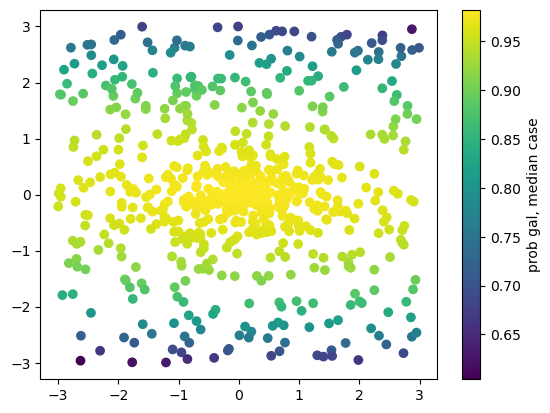

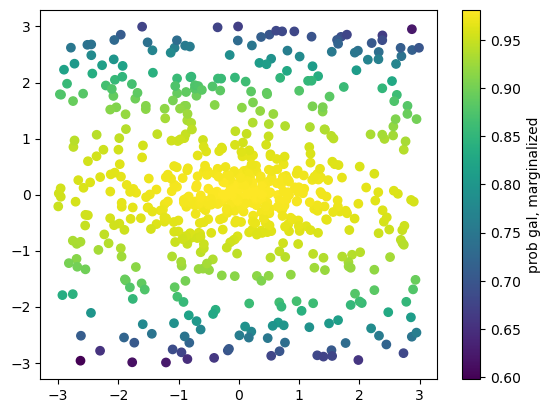

In [225]:
medians = [dynesty.utils.quantile(ss, .5, weights=res.importance_weights())[0] for ss in res.samples.T]
_, lgal, lbkg = loglike(medians, test_data, test_region, retcomponents=True)

fig = plt.figure()
plt.scatter(*test_data, c=np.exp(lgal - np.logaddexp(lgal, lbkg)))
cb = plt.colorbar().set_label('prob gal, median case')

display(fig)
plt.close()

llf, llb = np.array([loglike(s, test_data, test_region, retcomponents=True)[1:] for s in res.samples]).transpose(1,0,2)
pfg = np.average(np.exp(llf-np.logaddexp(llf, llb)), axis=0, weights=res.importance_weights())

fig = plt.figure()
plt.scatter(*test_data, c=pfg)
cb = plt.colorbar().set_label('prob gal, marginalized')

display(fig)
plt.close()

# Summary

It looks like the discrepencies from the input values are driven mostly by Re wanting to be very high. A strong prior on Re gives nearly everything else correct, although $n$ can be a bit wonky. Nothing else seems to give reliable results, though.

Even for the exponential case this is true - why is that different from the circular exp case??